In [1]:
import sys
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib as mpl

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
import seaborn as sns

import os

import bbknn

In [7]:
sc.settings.set_figure_params(dpi=80)

# Functions

In [3]:
# This function selects the data for multiple slides from the spatial anndata object.
# Modified `select_slide` in cell2loc for multiple slides

# @param adata: anndata object with multiple spatial experiments
# @param s: list of selected slides
# @param s_col: column in adata.obs listing experiment name for each location

def select_multislide(adata, s, s_col='sample'):

    slides = adata[adata.obs[s_col].isin(s), :]
    s_keys = list(slides.uns['spatial'].keys())
    
    uns_dict = {}
    for ss in s:
        s_spatial=np.array(s_keys)[[ss in k for k in s_keys]][0]
        uns_dict[s_spatial]=slides.uns['spatial'][s_spatial]
    
    slides.uns['spatial'] = uns_dict

    return slides

# Cell types for supporting annotation

In [4]:
celltypes_for_annotation = {
    'Atrium':['AtrialCardiomyocytesLeft','AtrialCardiomyocytesRight'],
    'Ventricle':['VentricularCardiomyocytesLeftCompact',
                 'VentricularCardiomyocytesRightCompact',
                 'VentricularCardiomyocytesLeftTrabeculated',
                 'VentricularCardiomyocytesRightTrabeculated'],
    'CCS':['SinoatrialNodeCardiomyocytes',
             'AtrioventricularNodeCardiomyocytes',
             'VentricularConductionSystemProximal',
             'VentricularConductionSystemDistal',],
    'Adventitia':['GreatVesselAdventitialFibroblasts','CoronaryVesselAdventitialFibroblasts'],
    'LN':['LymphNodeFibroblasticReticularCells'],
    'Valve':['ValveInterstitialCells'],
    'Endocardium':['EndocardialCells','EndocardialCushionCells'],
    'Epicardium':['MesothelialEpicardialCells','EpicardiumDerivedCells'],
    'DuctusArteriosus':['DuctusArteriosusSmoothMuscleCells']
}

# Read in anndata

In [8]:
# the anndata has "gene expression" in .X
# cell2location output is in .obsm['q05_cell_abundance_w_sf']
# kNN graph for UMAP/clustering was generated using cell2location output
adata_vis = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/visium_foetal_healthy-all_raw.h5ad')
adata_vis

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 39223 × 33562
    obs: 'array_row', 'array_col', 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'sangerID', 'Publication', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'status', 'cell2loc-map_group', 'JC_edit', 'sample_for_cell2loc', 'week', 'leiden', 'region_cluster', 'AtrialCardiomyocytesLeft', 'AtrialCardiomyocytesRight', 'VentricularCardiomyocytesLeftCompact', 'VentricularCardiomyocytesRightCompact', 'VentricularCardiomyocytesLeftTrabeculated', 'VentricularCardiomyocytesRightTrabeculated', 'SinoatrialNodeCardiomyocytes', 'AtrioventricularNodeCardiomyocytes', 'VentricularConductionSystemProximal', 'VentricularConductionSystemDistal', 'GreatVesselAdventitialFibroblasts'

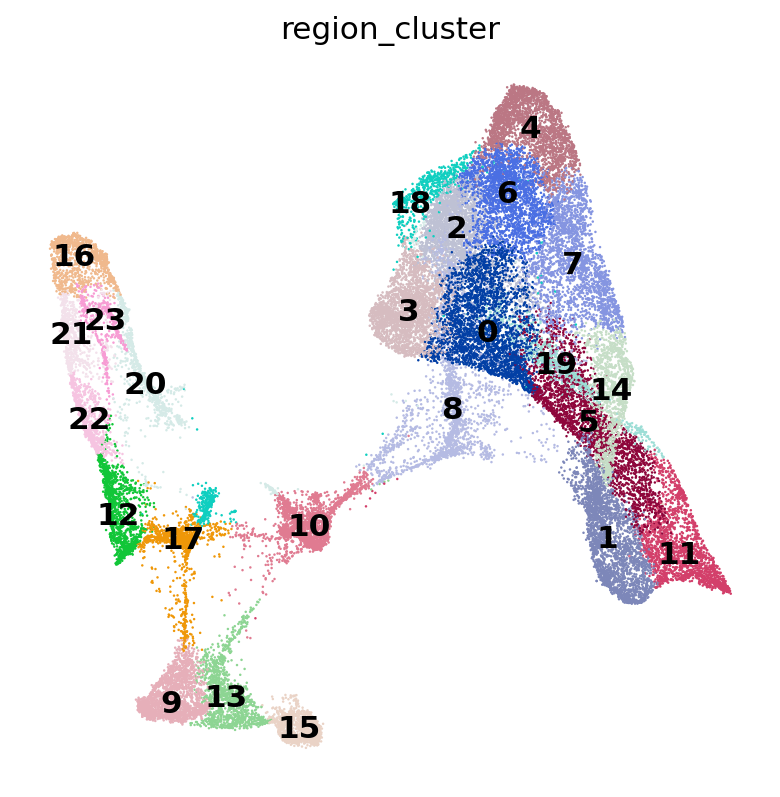

In [9]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_vis, color=['region_cluster'], size=5,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=14, frameon=False, legend_loc='on data')

In [10]:
# add cell2loc out to .obs
cellnames = adata_vis.obsm['q05_cell_abundance_w_sf'].columns
cellnames = [x.split('q05cell_abundance_w_sf_')[1] for x in cellnames]
adata_vis.obs[cellnames] = adata_vis.obsm['q05_cell_abundance_w_sf'].copy()

# add normalise cell2loc output: min-max
df = adata_vis.obsm['q05_cell_abundance_w_sf'].copy()
df = (df-df.min())/(df.max()-df.min())
adata_vis.obs[[f'{x}_minmax' for x in cellnames]] = df.copy()

##### Atrium #####


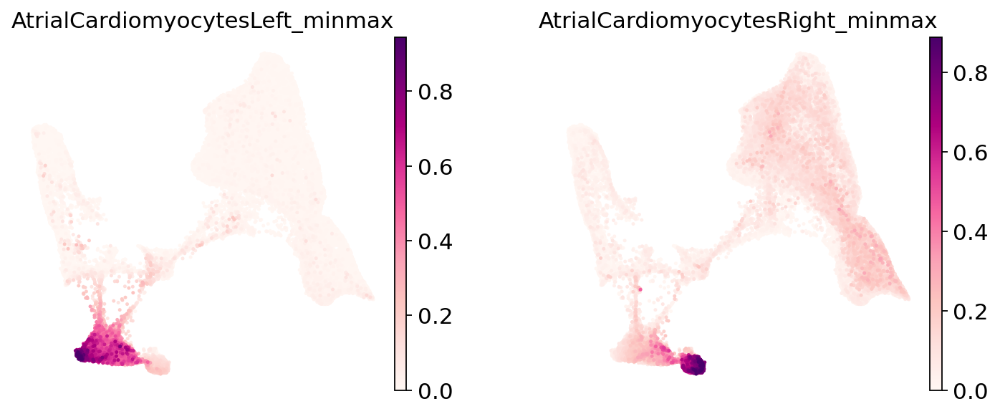

##### Ventricle #####


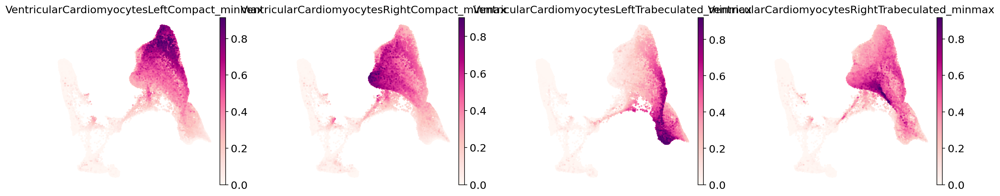

##### CCS #####


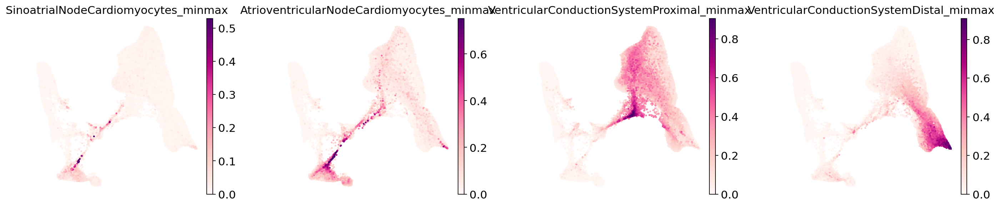

##### Adventitia #####


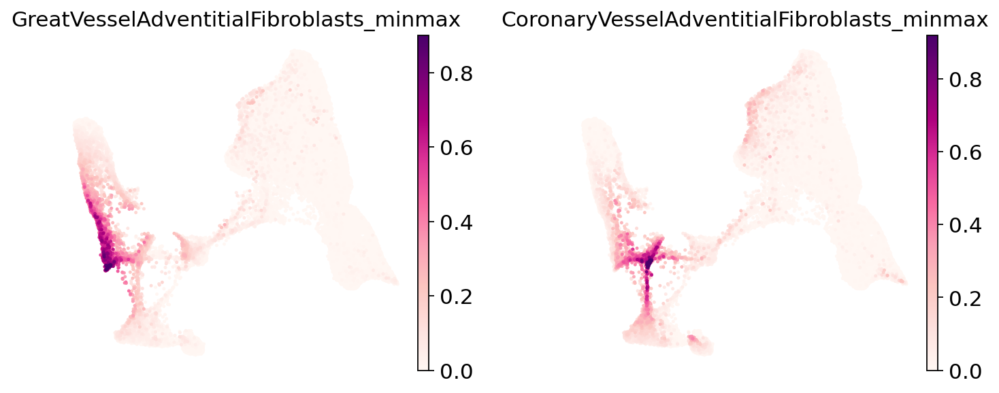

##### LN #####


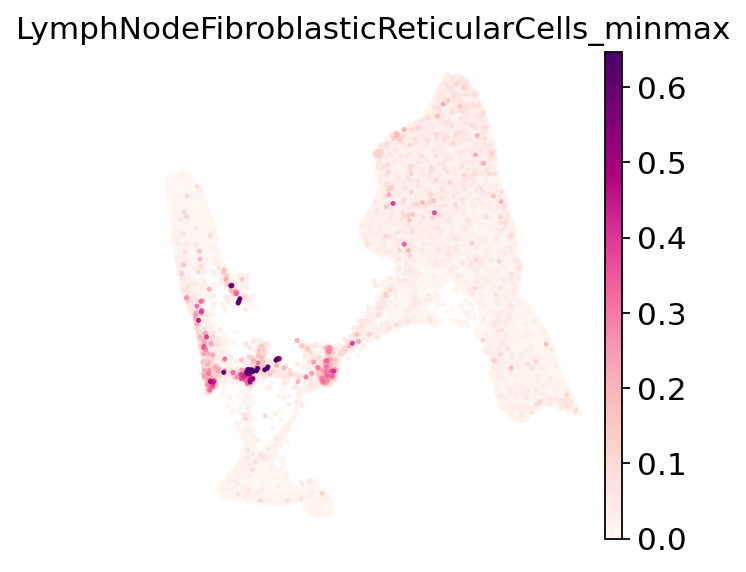

##### Valve #####


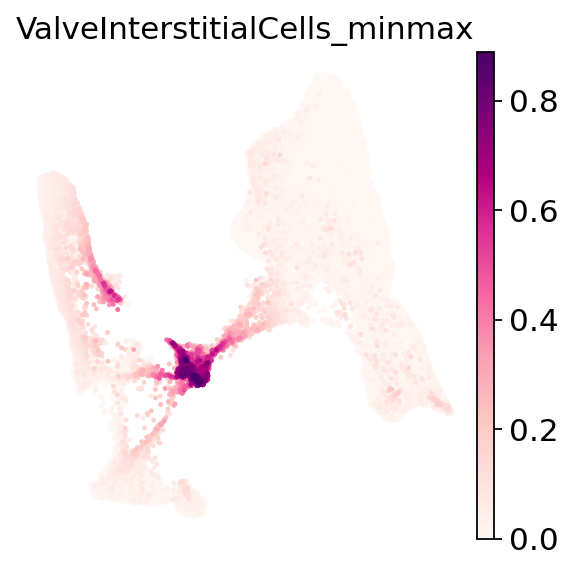

##### Endocardium #####


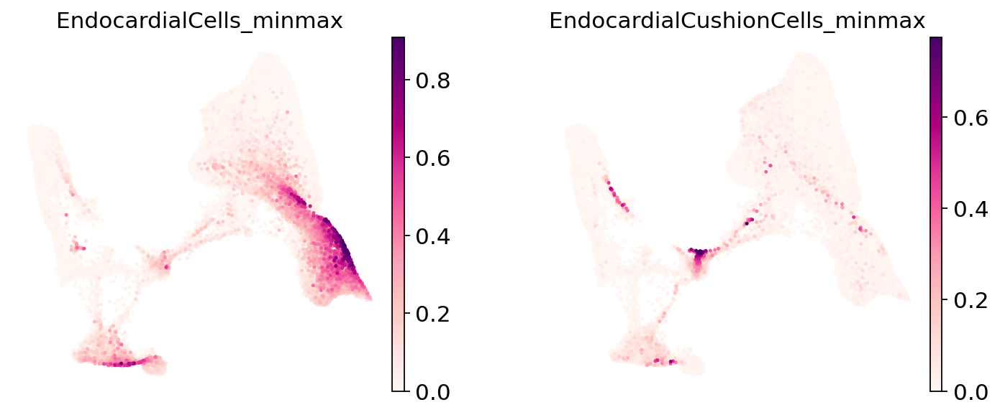

##### Epicardium #####


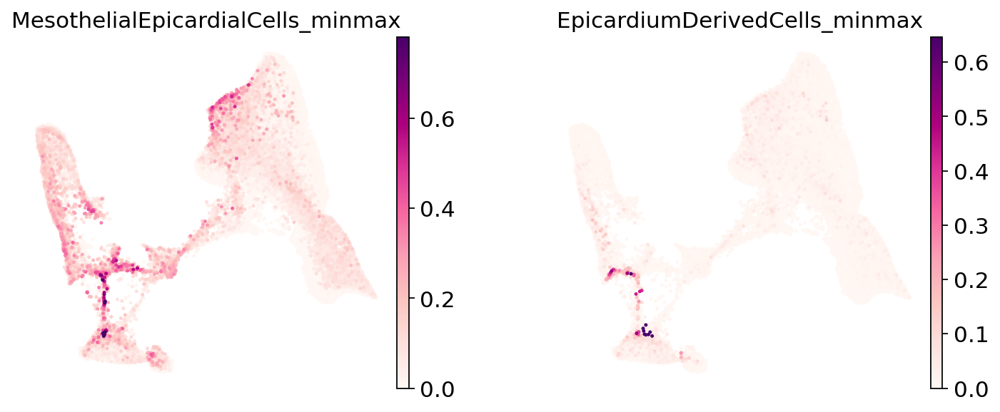

##### DuctusArteriosus #####


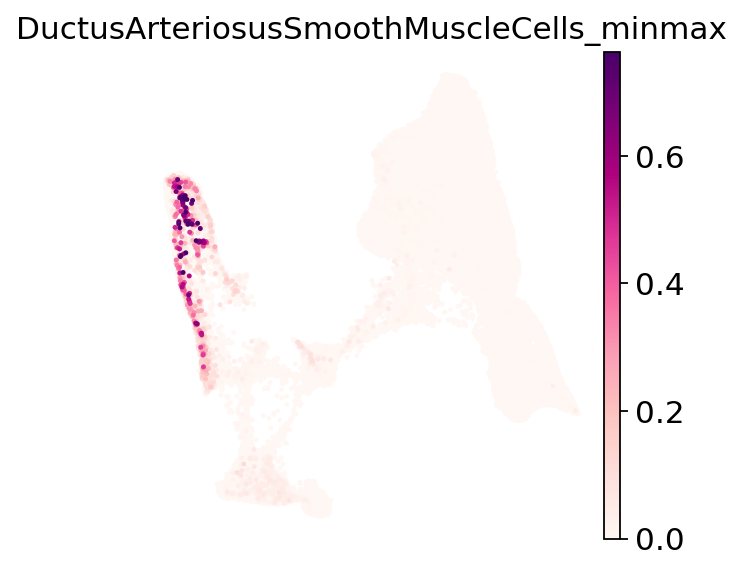

In [11]:
for structure,celltypes in celltypes_for_annotation.items():
    print(f'##### {structure} #####')
    with mpl.rc_context({'axes.facecolor':  'white',
                         'figure.figsize': [4, 4]}):
        sc.pl.umap(adata_vis, color=[f'{x}_minmax' for x in celltypes], size=20,
                   color_map = 'RdPu', ncols = 4, wspace=0.3, vmax='p99.98',
                   legend_fontsize=14, frameon=False)

# Annotate

In [12]:
adata_vis.obs['annotation'] = adata_vis.obs['region_cluster']
adata_vis.obs['annotation'] = adata_vis.obs['annotation'].astype('str')
adata_vis.obs.replace({'annotation': {
    '0': 'Ventricle', 
    '1': 'Ventricle', 
    '2': 'Ventricle', 
    '3': 'Ventricle', 
    '4': 'Ventricle', 
    '5': 'Ventricle', 
    '6': 'Ventricle', 
    '7': 'Ventricle', 
    '8': 'Ventricle', 
    '9': 'Atrium', 
    '10': 'AV ring - Valves', 
    '11': 'Ventricle', 
    '12': 'Vessels', 
    '13': 'Atrium', 
    '14': 'Ventricle', 
    '15': 'Atrium', 
    '16': 'Vessels', 
    '17': 'Vessels', 
    '18': 'Ventricle', 
    '19': 'Ventricle',   
    '20': 'Vessels', 
    '21': 'Vessels', 
    '22': 'Vessels', 
    '23': 'Vessels', 
}}, inplace=True)

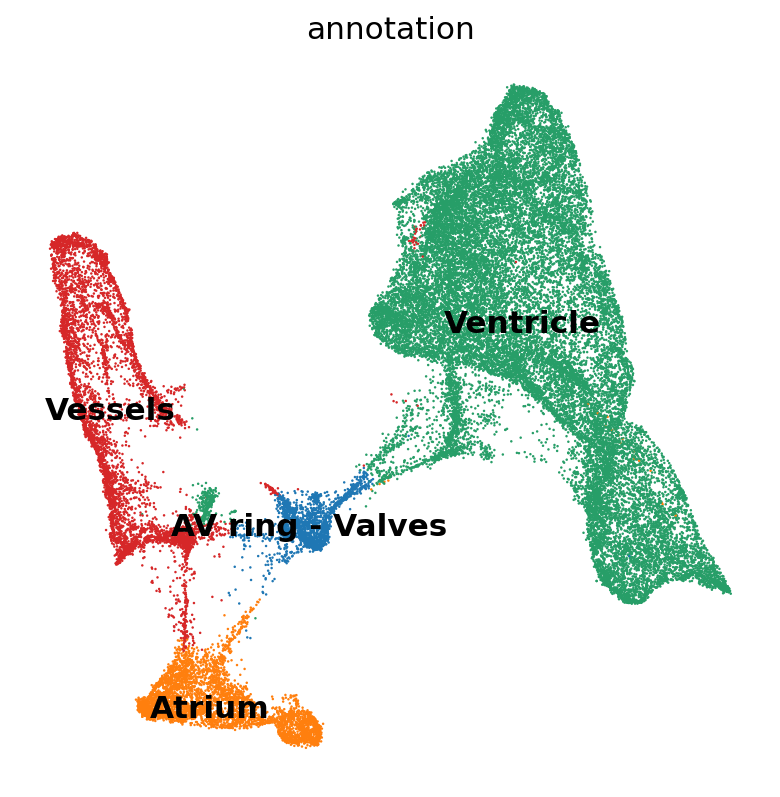

In [13]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_vis, color=['annotation'], size=5,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=14, frameon=False, legend_loc='on data')

In [14]:
set(adata_vis.obs['annotation'])

{'AV ring - Valves', 'Atrium', 'Ventricle', 'Vessels'}

In [15]:
# save annotations
annot_df = adata_vis.obs[['annotation']].copy()
annot_df.rename(columns={'annotation':'global_annotation'},inplace=True)
annot_df.head()

,global_annotation
spot_id,
HCAHeartST10298114_AAACAAGTATCTCCCA-1,Ventricle
HCAHeartST10298114_AAACATTTCCCGGATT-1,Ventricle
HCAHeartST10298114_AAACGAGACGGTTGAT-1,Ventricle
HCAHeartST10298114_AAACTCGTGATATAAG-1,Vessels
HCAHeartST10298114_AAACTGCTGGCTCCAA-1,Ventricle


# Subset and re-integration - Myocardium

In [16]:
structures = ['AV ring - Valves','Atrium','Ventricle']

In [17]:
# subset
adata_sub = adata_vis[adata_vis.obs['annotation'].isin(structures)]

# # compute KNN using the cell2location output stored in adata.obsm
# bbknn
bbknn.bbknn(adata_sub, batch_key='sample_for_cell2loc', use_rep='q05_cell_abundance_w_sf_ndarray')

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_sub, resolution=2)

# add region as categorical variable
adata_sub.obs["region_cluster"] = adata_sub.obs["leiden"].astype("category")

# compute UMAP using KNN graph based on the cell2location output
sc.tl.umap(adata_sub, min_dist = 0.2, spread = 1)  # n_components=3

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:179: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  ovld.data[key] = neighbors
/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


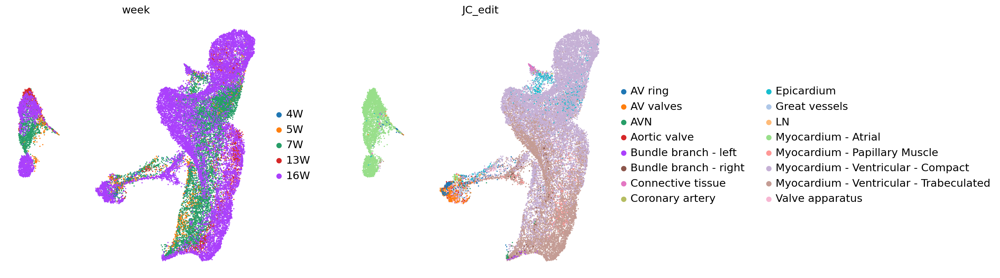

In [18]:
# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_sub, color=['week','JC_edit'], size=10,
               color_map = 'RdPu', ncols = 3, wspace=0.2,
               legend_fontsize=14, frameon=False, components='all')

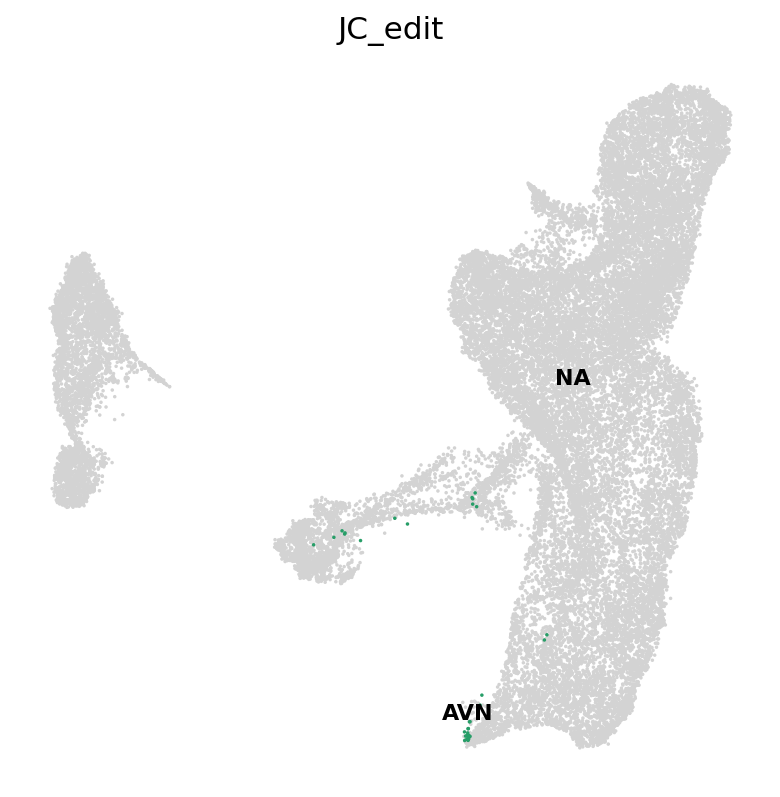

In [19]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_sub, color=['JC_edit'], groups='AVN',size=10,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

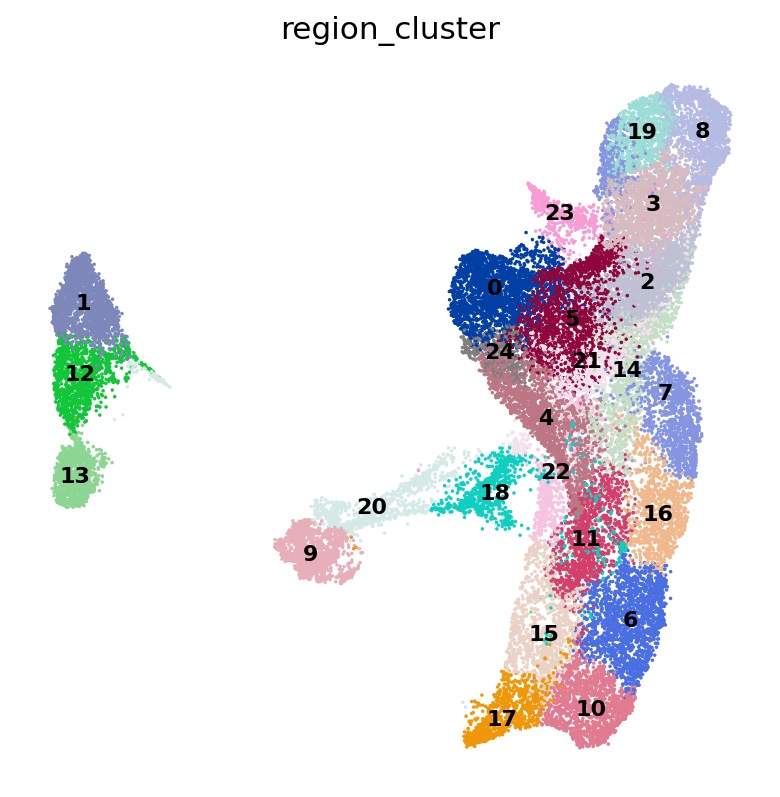

In [20]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_sub, color=['region_cluster'], size=10,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

##### Atrium #####


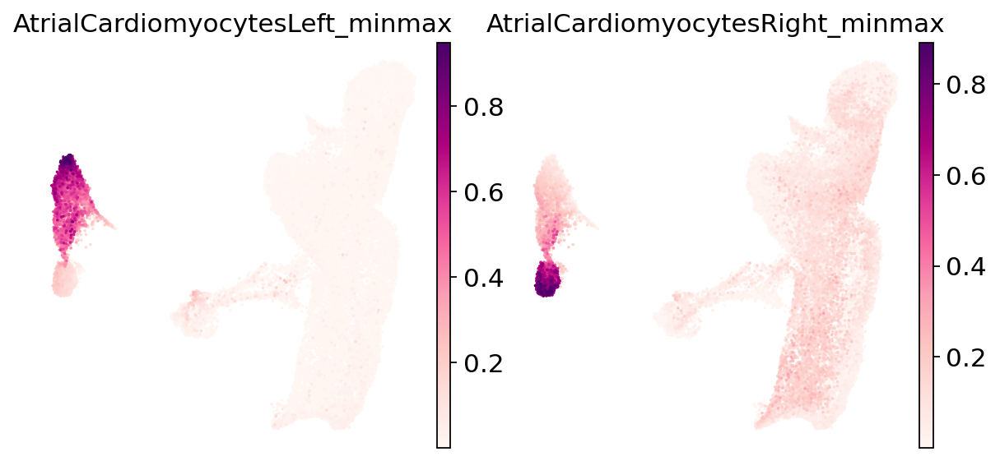

##### Ventricle #####


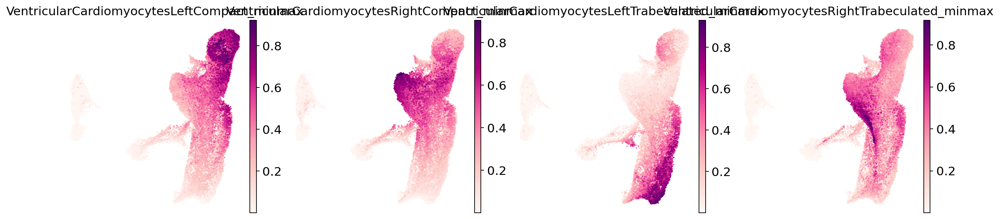

##### CCS #####


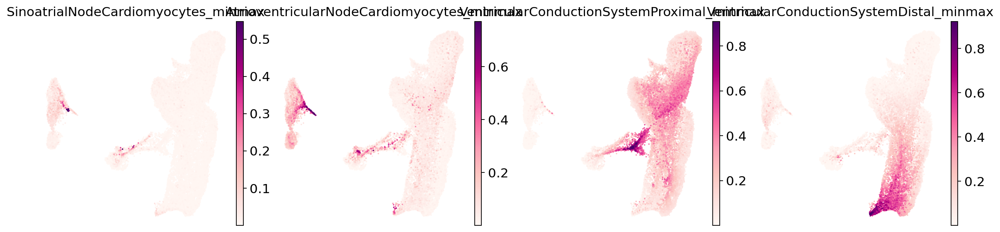

##### Adventitia #####


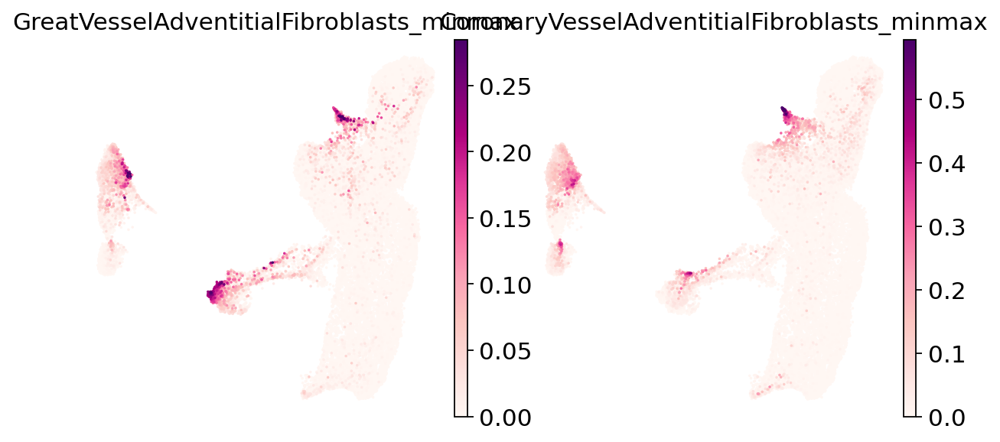

##### LN #####


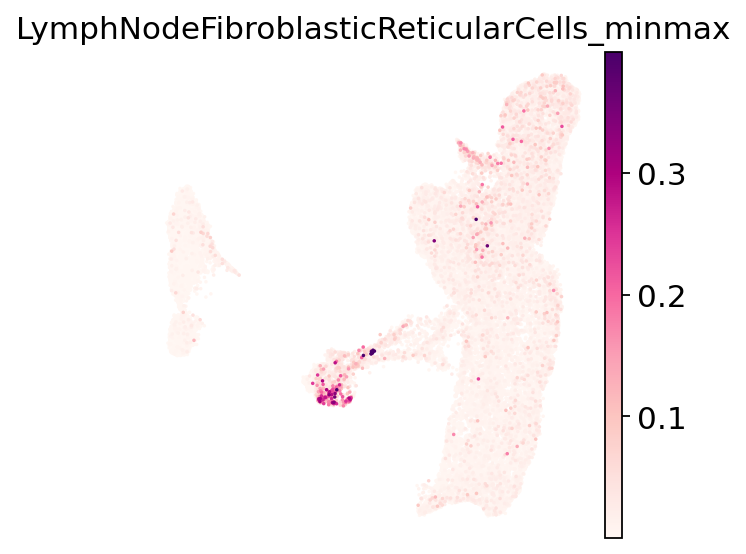

##### Valve #####


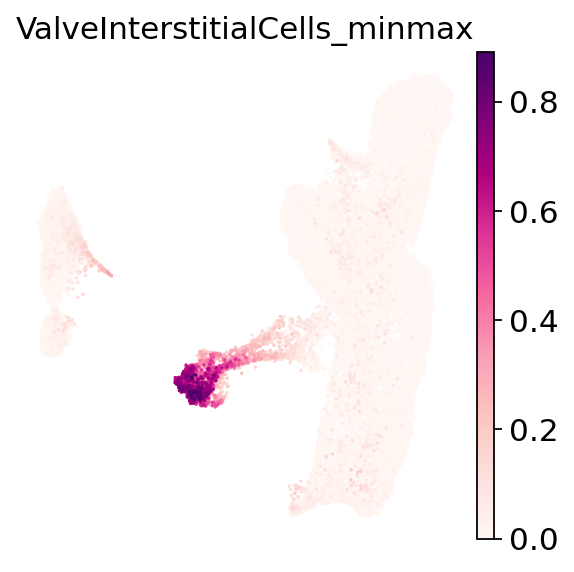

##### Endocardium #####


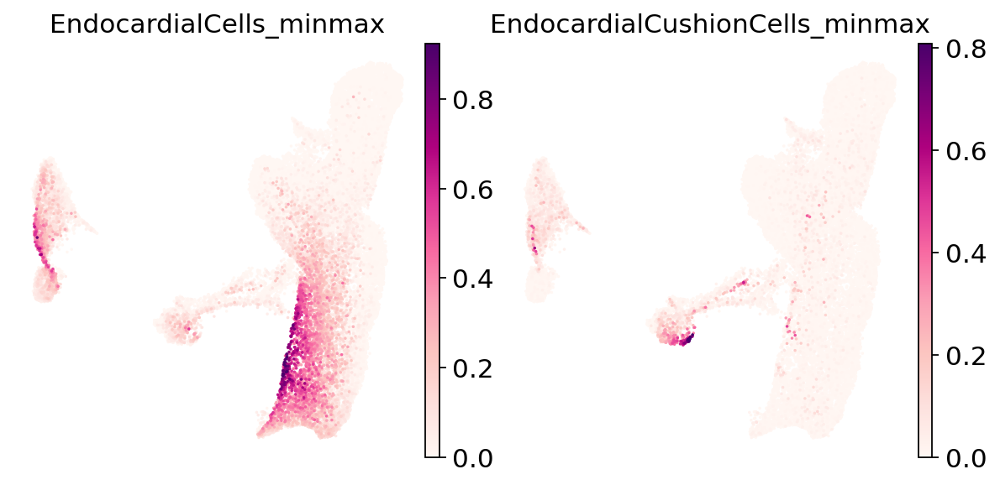

##### Epicardium #####


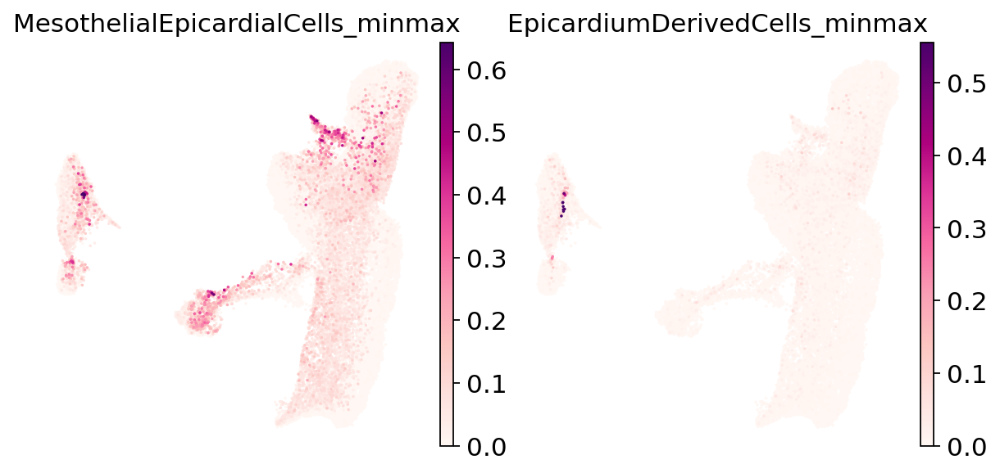

##### DuctusArteriosus #####


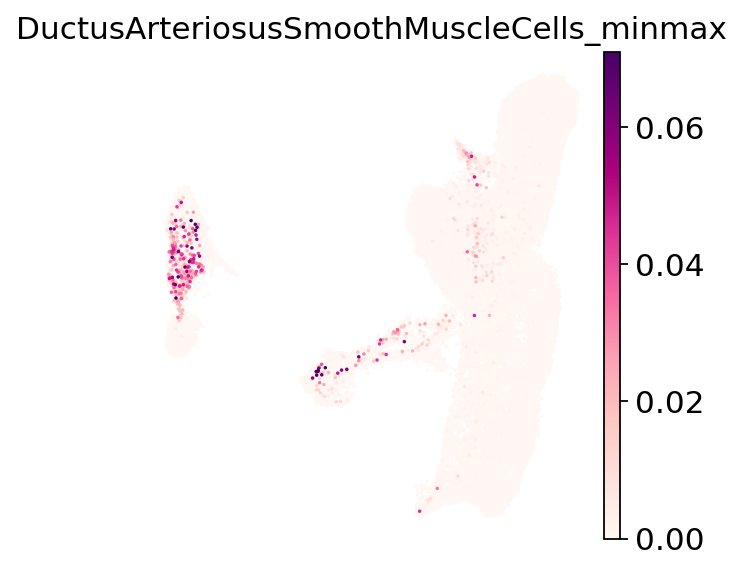

In [21]:
for structure,celltypes in celltypes_for_annotation.items():
    print(f'##### {structure} #####')
    with mpl.rc_context({'axes.facecolor':  'white',
                         'figure.figsize': [4, 4]}):
        sc.pl.umap(adata_sub, color=[f'{x}_minmax' for x in celltypes], size=10,
                   color_map = 'RdPu', ncols = 4, wspace=0.1, vmax='p99.98',
                   legend_fontsize=14, frameon=False)

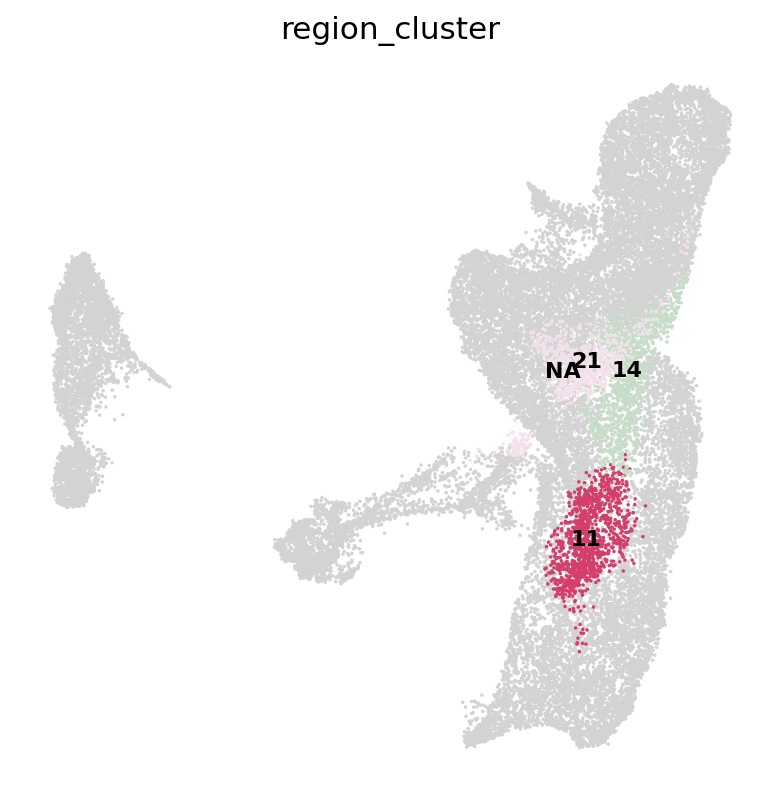

In [22]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_sub, color=['region_cluster'], groups=['11','14','21'],size=10,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

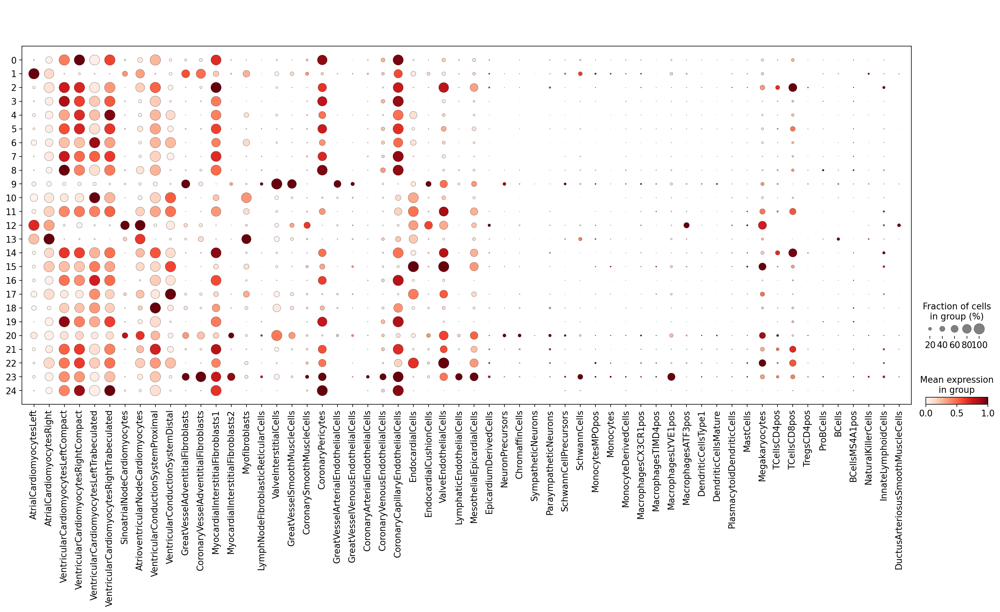

In [23]:
adata_sub.var_names_make_unique()
sc.pl.dotplot(adata_sub,
              cellnames, 
              groupby='region_cluster',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

In [24]:
adata_sub.obs['annotation'] = adata_sub.obs['region_cluster']
adata_sub.obs['annotation'] = adata_sub.obs['annotation'].astype('str')
adata_sub.obs.replace({'annotation': {
    '0': 'Ventricle - Compact - Right', 
    '1': 'tbd - Atrium - Left', 
    '2': 'Ventricle - Compact - Left', 
    '3': 'Ventricle - Compact - Left', 
    '4': 'Ventricle - Trabeculated - Right', 
    '5': 'Ventricle - Compact - Right',  
    '6': 'Ventricle - Trabeculated - Left', 
    '7': 'Ventricle - Compact - Left',  
    '8': 'Ventricle - Compact - Left',  
    '9': 'tbd - CCS, Valves', 
    '10': 'Ventricle - Trabeculated - Left', 
    '11': 'tbd - Ventricle', 
    '12': 'tbd - Atrium - Left', 
    '13': 'tbd - Atrium - Right', 
    '14': 'tbd - Ventricle', 
    '15': 'Endocardium - Ventricular', 
    '16': 'Ventricle - Trabeculated - Left', 
    '17': 'VCS - Distal', 
    '18': 'tbd - CCS, Valves', 
    '19': 'Ventricle - Compact - Left',  
    '20': 'tbd - CCS, Valves', 
    '21': 'tbd - Ventricle', 
    '22': 'Endocardium - Ventricular', 
    '23': 'Adventitia - Coronary', 
    '24': 'Ventricle - Compact - Right', 
}}, inplace=True)

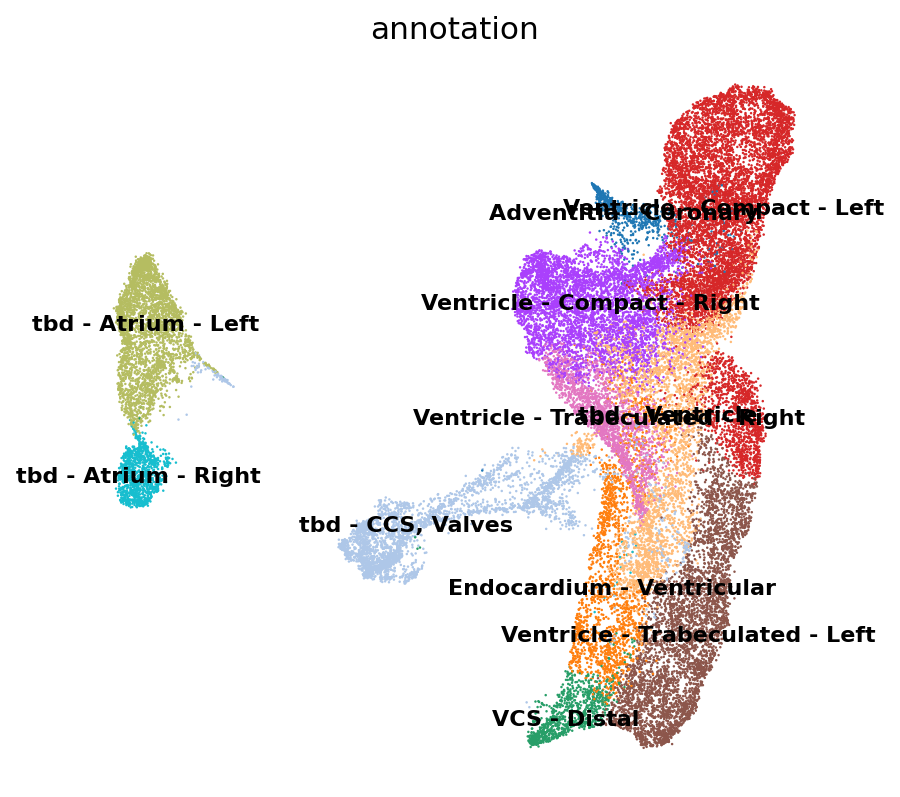

In [25]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_sub, color=['annotation'], size=5,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=10, frameon=False, legend_loc='on data')

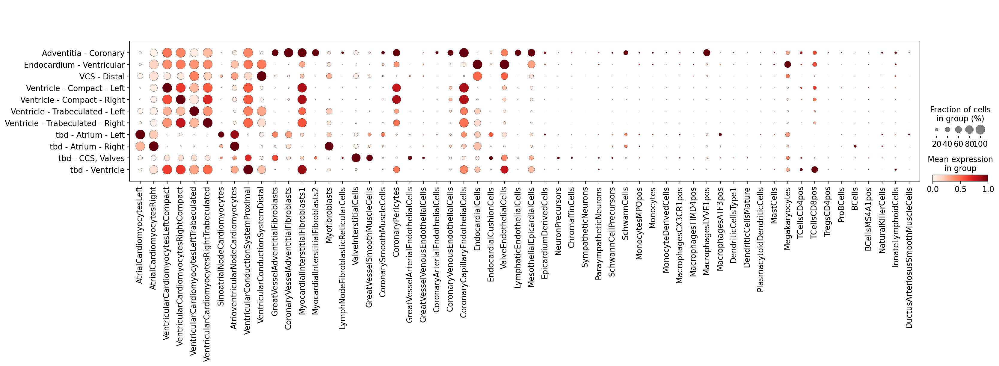

In [26]:
adata_sub.var_names_make_unique()
sc.pl.dotplot(adata_sub,
              cellnames, 
              groupby='annotation',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

In [27]:
# get annotation
annot_df['myocardium_annotation'] = adata_sub.obs['annotation'].reindex(annot_df.index)
annot_df.head()

,global_annotation,myocardium_annotation
spot_id,,
HCAHeartST10298114_AAACAAGTATCTCCCA-1,Ventricle,Endocardium - Ventricular
HCAHeartST10298114_AAACATTTCCCGGATT-1,Ventricle,tbd - Ventricle
HCAHeartST10298114_AAACGAGACGGTTGAT-1,Ventricle,Ventricle - Compact - Right
HCAHeartST10298114_AAACTCGTGATATAAG-1,Vessels,NaN
HCAHeartST10298114_AAACTGCTGGCTCCAA-1,Ventricle,Ventricle - Compact - Right


# Subset and re-integration - CCS, Valve cells

In [28]:
structures = ['tbd - CCS, Valves']

# get index
indices = list(annot_df.index[annot_df['myocardium_annotation'].isin(structures)])

In [29]:
# subset
adata_sub = adata_vis[indices]

# # compute KNN using the cell2location output stored in adata.obsm
# bbknn
bbknn.bbknn(adata_sub, batch_key='sample_for_cell2loc', use_rep='q05_cell_abundance_w_sf_ndarray')

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_sub, resolution=2)

# add region as categorical variable
adata_sub.obs["region_cluster"] = adata_sub.obs["leiden"].astype("category")

# compute UMAP using KNN graph based on the cell2location output
sc.tl.umap(adata_sub, min_dist = 0.2, spread = 1)  # n_components=3

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:179: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  ovld.data[key] = neighbors
/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


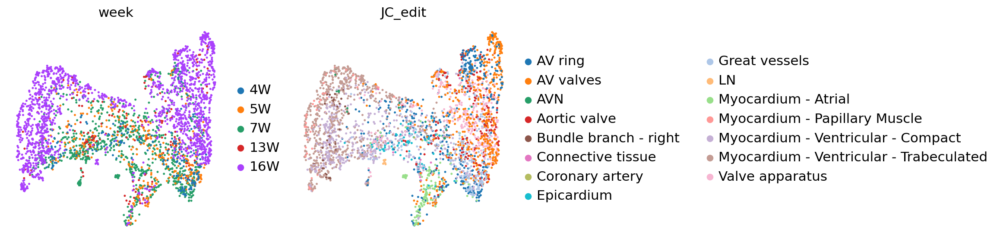

In [30]:
# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [4, 4]}):
    sc.pl.umap(adata_sub, color=['week','JC_edit'], size=20,
               color_map = 'RdPu', ncols = 3, wspace=0.2,
               legend_fontsize=14, frameon=False, components='all')

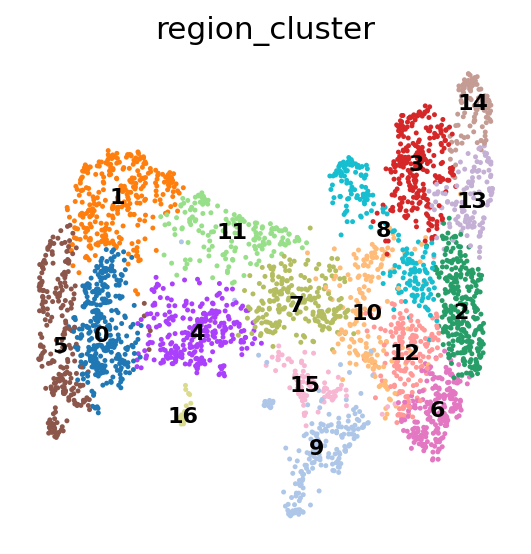

In [31]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [4, 4]}):
    sc.pl.umap(adata_sub, color=['region_cluster'], size=20,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

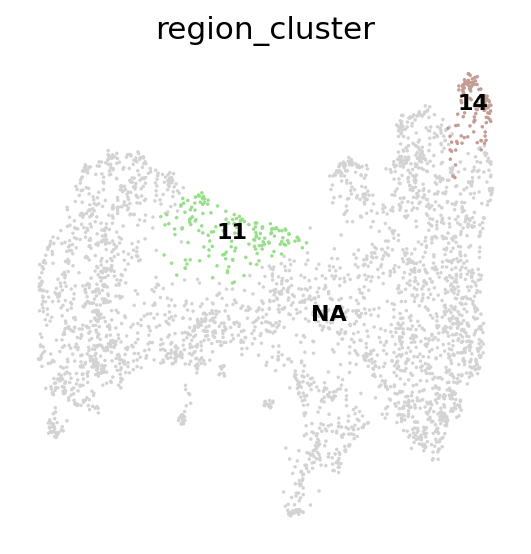

In [32]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [4, 4]}):
    sc.pl.umap(adata_sub, color=['region_cluster'], groups=['11','14','21','23'],size=10,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

##### Atrium #####


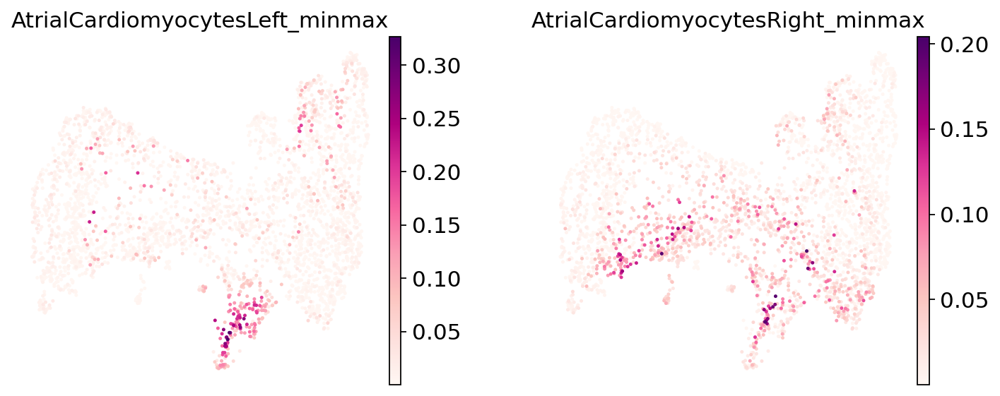

##### Ventricle #####


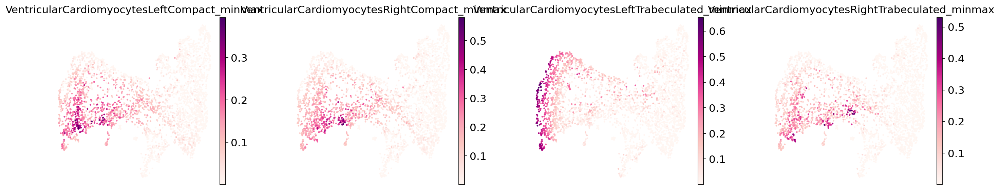

##### CCS #####


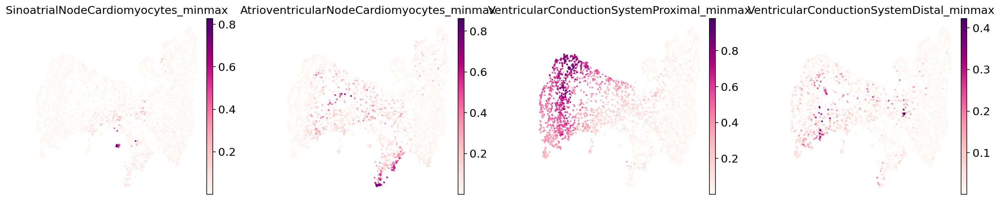

##### Adventitia #####


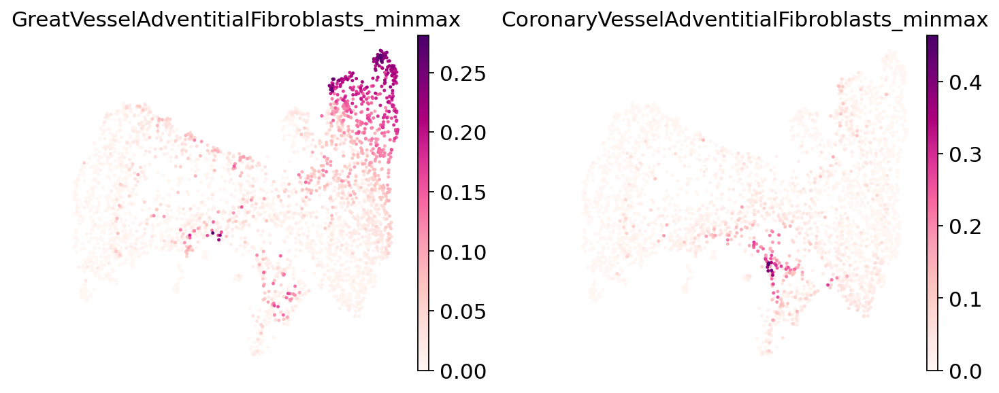

##### LN #####


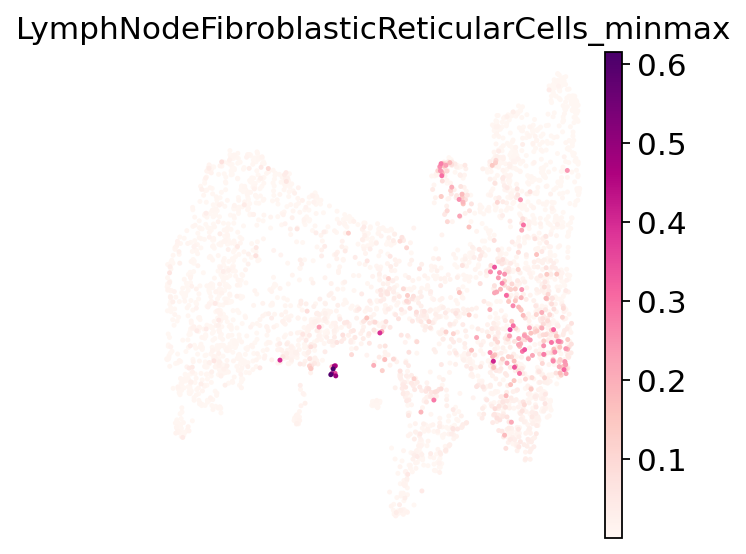

##### Valve #####


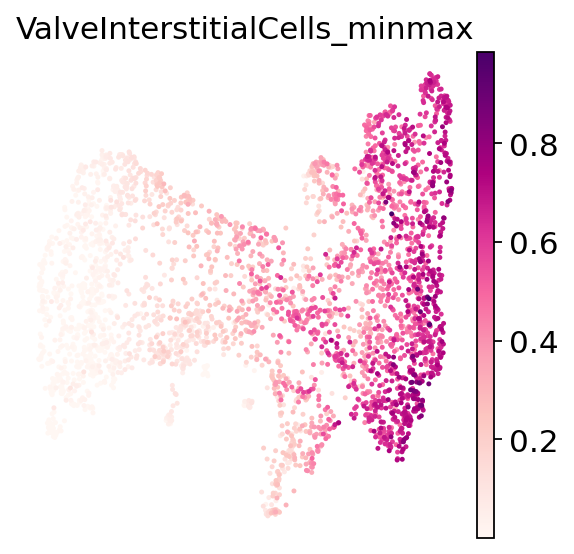

##### Endocardium #####


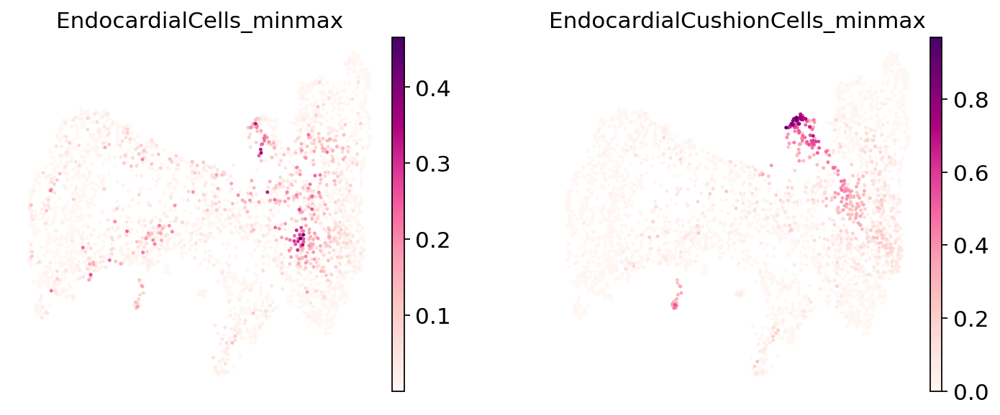

##### Epicardium #####


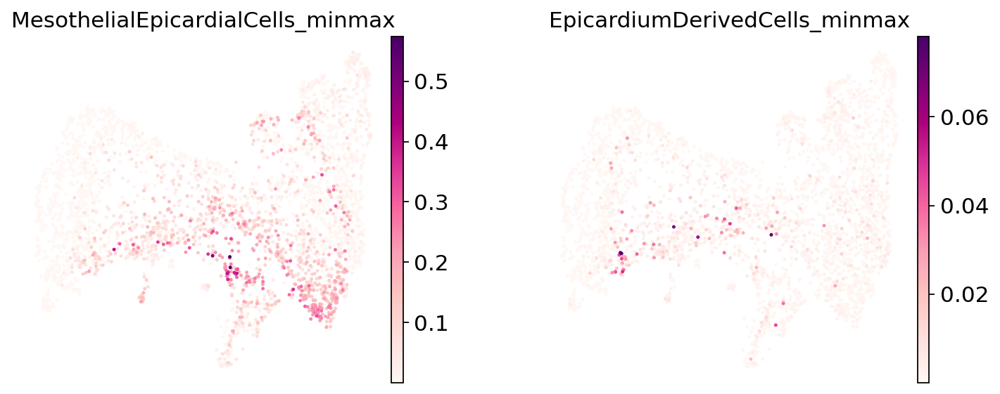

##### DuctusArteriosus #####


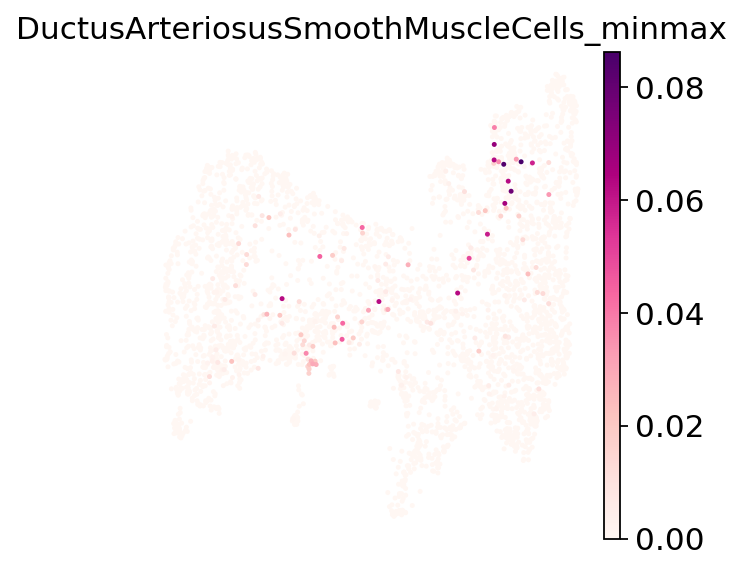

In [33]:
for structure,celltypes in celltypes_for_annotation.items():
    print(f'##### {structure} #####')
    with mpl.rc_context({'axes.facecolor':  'white',
                         'figure.figsize': [4, 4]}):
        sc.pl.umap(adata_sub, color=[f'{x}_minmax' for x in celltypes], size=20,
                   color_map = 'RdPu', ncols = 4, wspace=0.3, vmax='p99.98',
                   legend_fontsize=14, frameon=False)

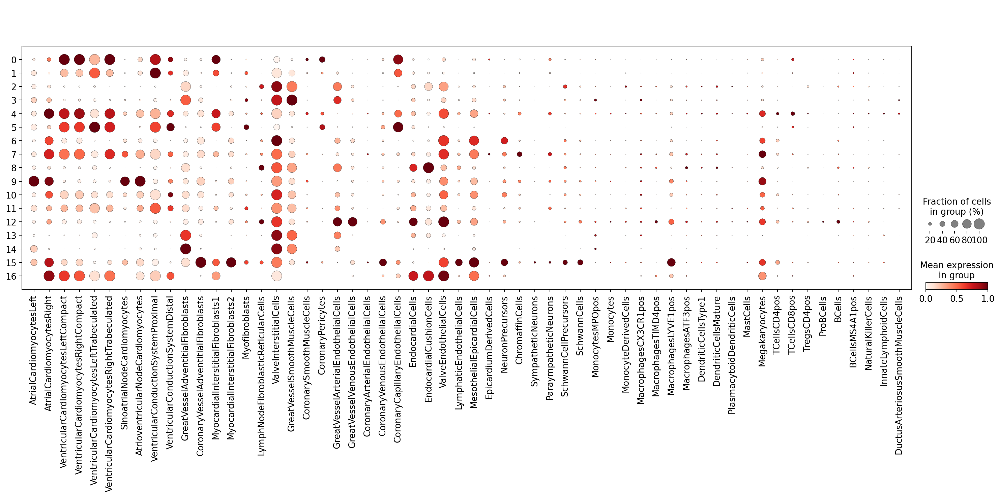

In [34]:
adata_sub.var_names_make_unique()
sc.pl.dotplot(adata_sub,
              cellnames, 
              groupby='region_cluster',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

In [35]:
adata_sub.obs['annotation'] = adata_sub.obs['region_cluster']
adata_sub.obs['annotation'] = adata_sub.obs['annotation'].astype('str')
adata_sub.obs.replace({'annotation': {
    '0': 'VCS - Proximal', 
    '1': 'VCS - Proximal', 
    '2': 'tbd - AVring, Valves', 
    '3': 'tbd - AVring, Valves', 
    '4': 'Ventricle - Compact - Right', 
    '5': 'Ventricle - Trabeculated - Left', 
    '6': 'tbd - AVring, Valves', 
    '7': 'tbd - AVring, Valves',  
    '8': 'Endocardial cusion',  
    '9': 'tbd - Nodes',  
    '10': 'tbd - AVring, Valves', 
    '11': 'VCS - Proximal', 
    '12': 'tbd - AVring, Valves', 
    '13': 'tbd - AVring, Valves', 
    '14': 'tbd - AVring, Valves', 
    '15': 'Adventitia - Coronary', 
    '16': 'Endocardial cusion', 
}}, inplace=True)

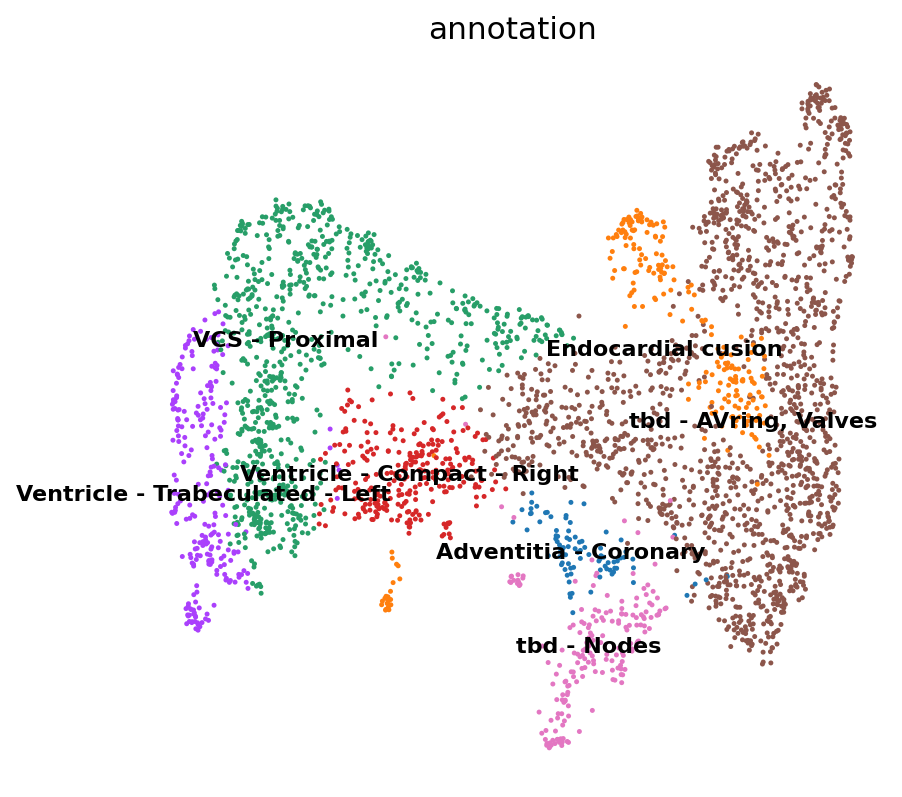

In [36]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_sub, color=['annotation'], size=20,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=10, frameon=False, legend_loc='on data')

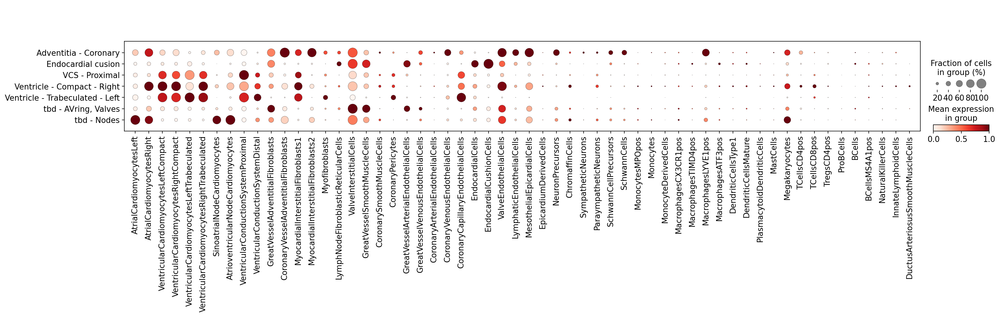

In [37]:
adata_sub.var_names_make_unique()
sc.pl.dotplot(adata_sub,
              cellnames, 
              groupby='annotation',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

In [38]:
# get annotation
annot_df['CCS-Valve_annotation'] = adata_sub.obs['annotation'].reindex(annot_df.index)
annot_df.head()

,global_annotation,myocardium_annotation,CCS-Valve_annotation
spot_id,,,
HCAHeartST10298114_AAACAAGTATCTCCCA-1,Ventricle,Endocardium - Ventricular,NaN
HCAHeartST10298114_AAACATTTCCCGGATT-1,Ventricle,tbd - Ventricle,NaN
HCAHeartST10298114_AAACGAGACGGTTGAT-1,Ventricle,Ventricle - Compact - Right,NaN
HCAHeartST10298114_AAACTCGTGATATAAG-1,Vessels,NaN,NaN
HCAHeartST10298114_AAACTGCTGGCTCCAA-1,Ventricle,Ventricle - Compact - Right,NaN


# Subset and re-integration - Atrium

In [39]:
structures = ['tbd - Atrium - Right','tbd - Atrium - Left']

# get index
indices = list(annot_df.index[annot_df['myocardium_annotation'].isin(structures)])

In [40]:
# subset
adata_sub = adata_vis[indices]

# # compute KNN using the cell2location output stored in adata.obsm
# bbknn
bbknn.bbknn(adata_sub, batch_key='sample_for_cell2loc', use_rep='q05_cell_abundance_w_sf_ndarray')

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_sub, resolution=1.5)

# add region as categorical variable
adata_sub.obs["region_cluster"] = adata_sub.obs["leiden"].astype("category")

# compute UMAP using KNN graph based on the cell2location output
sc.tl.umap(adata_sub, min_dist = 0.2, spread = 1)  # n_components=3

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:179: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  ovld.data[key] = neighbors
/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


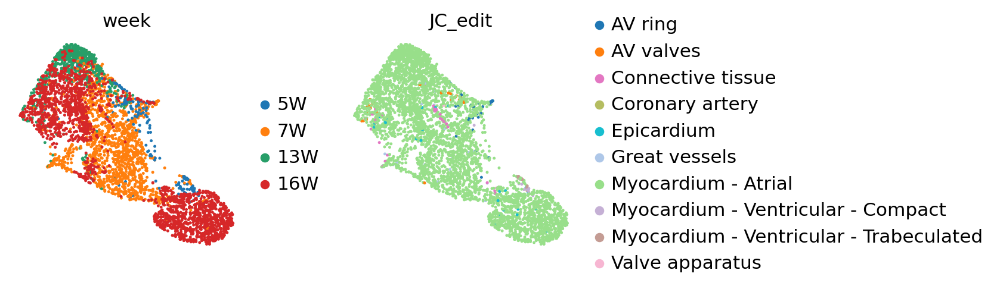

In [41]:
# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['week','JC_edit'], size=20,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=14, frameon=False, components='all')

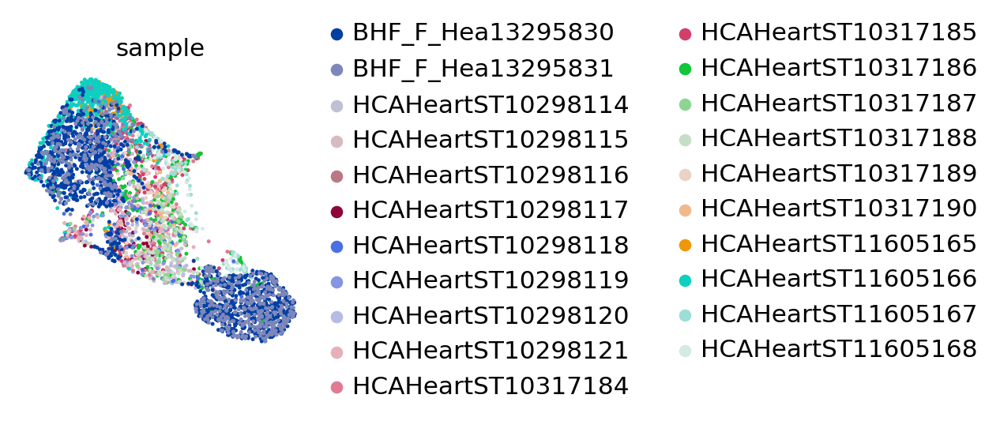

In [42]:
# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['sample'], size=20,
               color_map = 'RdPu', ncols = 3, wspace=0.2,
               legend_fontsize=14, frameon=False, components='all')

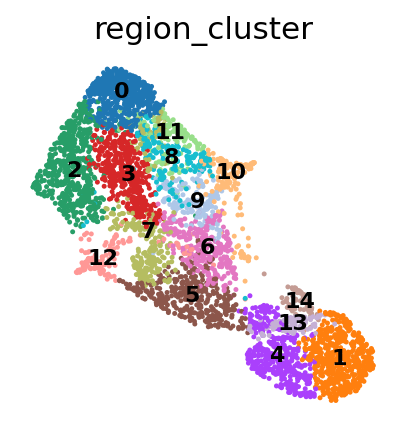

In [43]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['region_cluster'], size=20,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

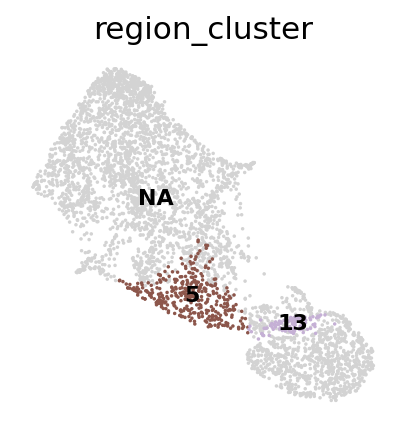

In [44]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['region_cluster'], groups=['5','13'],size=10,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

##### Atrium #####


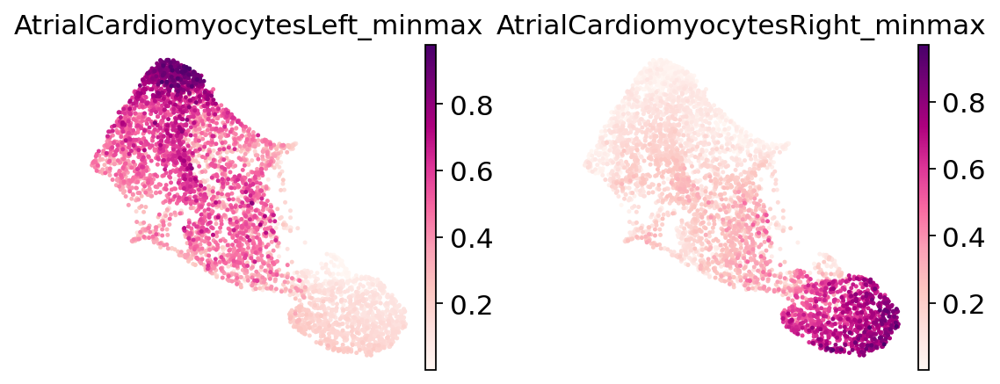

##### Ventricle #####


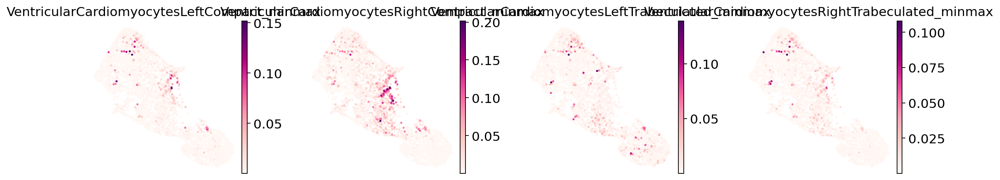

##### CCS #####


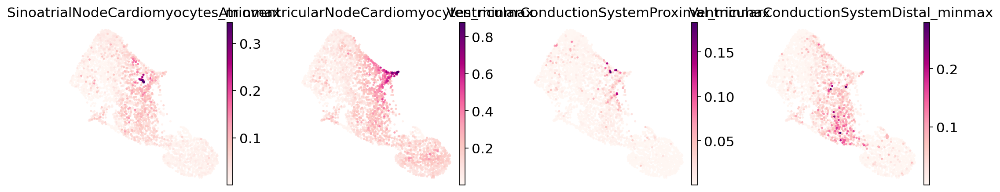

##### Adventitia #####


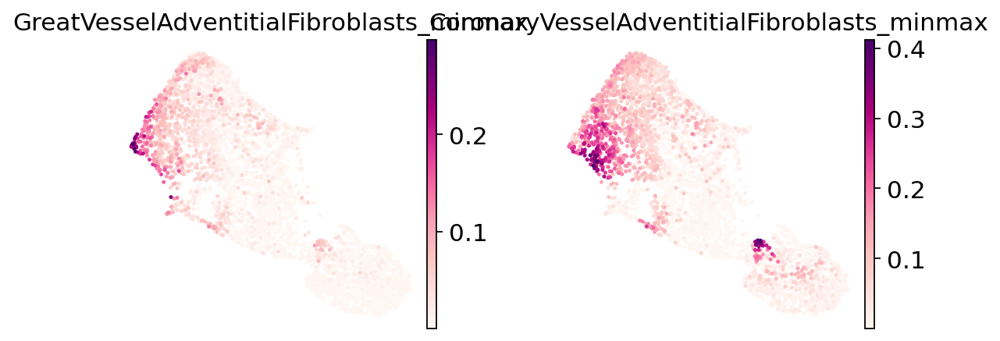

##### LN #####


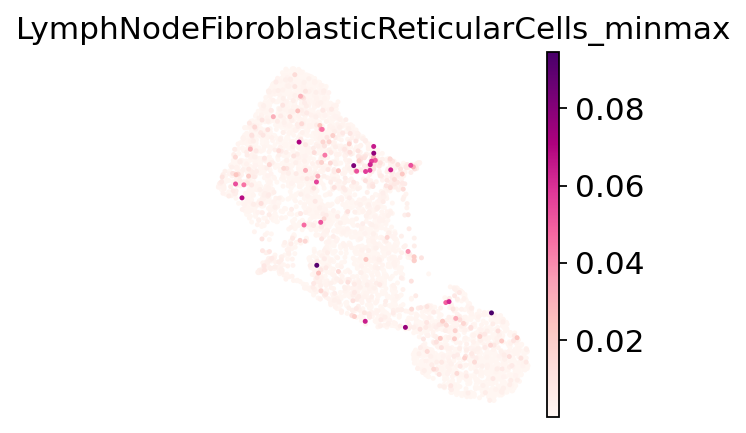

##### Valve #####


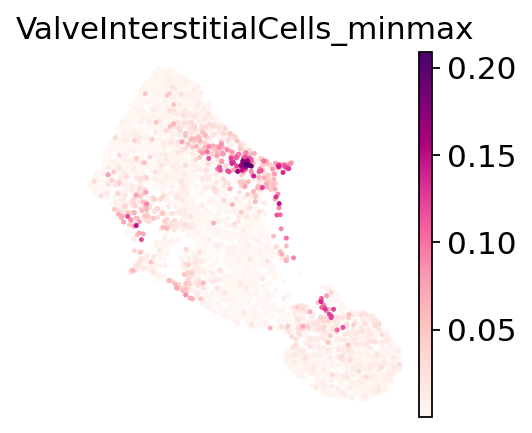

##### Endocardium #####


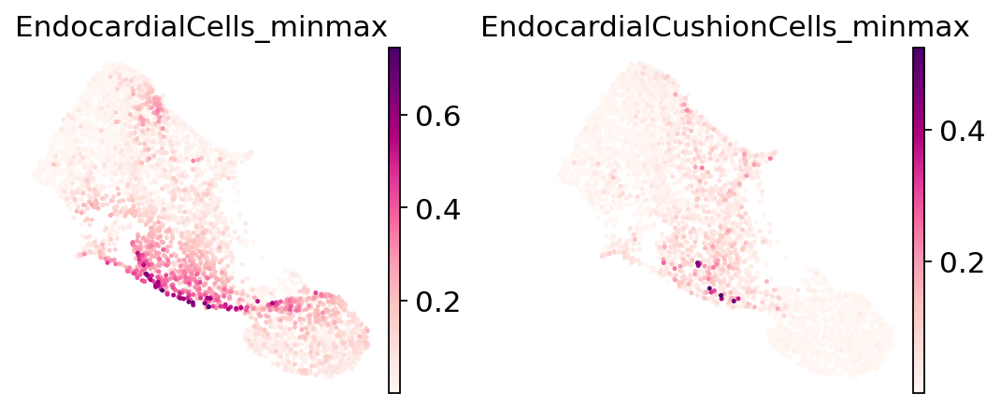

##### Epicardium #####


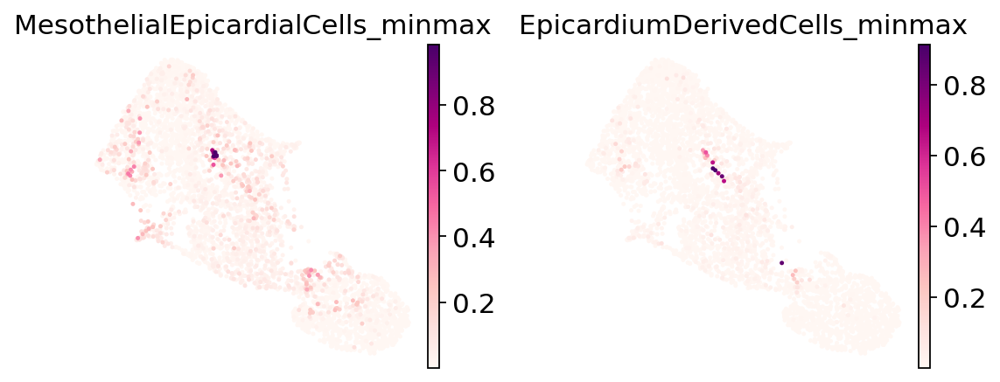

##### DuctusArteriosus #####


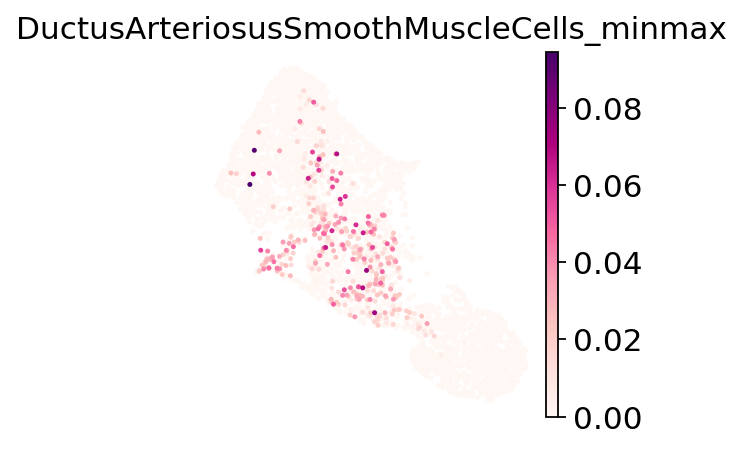

In [45]:
for structure,celltypes in celltypes_for_annotation.items():
    print(f'##### {structure} #####')
    with mpl.rc_context({'axes.facecolor':  'white',
                         'figure.figsize': [3, 3]}):
        sc.pl.umap(adata_sub, color=[f'{x}_minmax' for x in celltypes], size=20,
                   color_map = 'RdPu', ncols = 4, wspace=0.3, vmax='p99.98',
                   legend_fontsize=14, frameon=False)

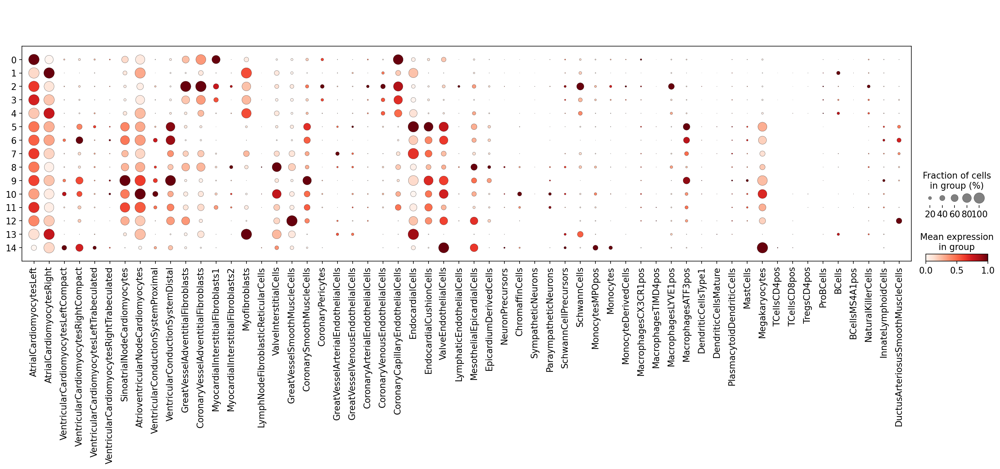

In [46]:
adata_sub.var_names_make_unique()
sc.pl.dotplot(adata_sub,
              cellnames, 
              groupby='region_cluster',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

In [47]:
adata_sub.obs['annotation'] = adata_sub.obs['region_cluster']
adata_sub.obs['annotation'] = adata_sub.obs['annotation'].astype('str')
adata_sub.obs.replace({'annotation': {
    '0': 'Atrium - Left', 
    '1': 'Atrium - Right', 
    '2': 'Adventitia - Coronary', 
    '3': 'Atrium - Left', 
    '4': 'Atrium - Right', 
    '5': 'Endocardium - Atrial', 
    '6': 'Atrium - Left', 
    '7': 'Atrium - Left', 
    '8': 'Atrium - Left', 
    '9': 'tbd - Nodes', 
    '10': 'tbd - Nodes', 
    '11': 'Atrium - Left', 
    '12': 'Atrium - Left', 
    '13': 'Endocardium - Atrial', 
    '14': 'Uncertain', 
}}, inplace=True)

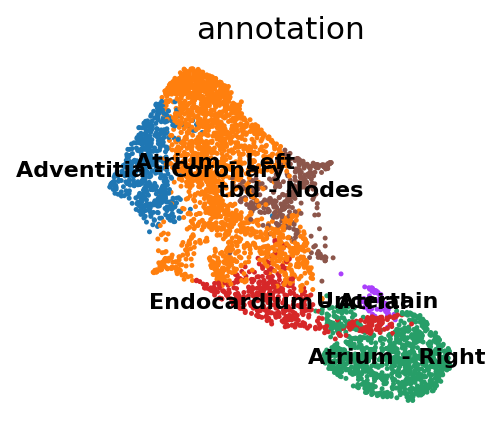

In [48]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['annotation'], size=20,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=10, frameon=False, legend_loc='on data')

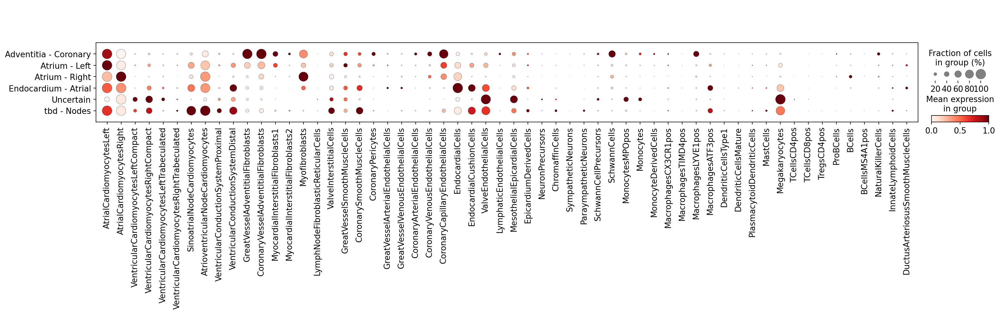

In [49]:
adata_sub.var_names_make_unique()
sc.pl.dotplot(adata_sub,
              cellnames, 
              groupby='annotation',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

In [50]:
# get annotation
annot_df['Atrium_annotation'] = adata_sub.obs['annotation'].reindex(annot_df.index)
annot_df.head()

,global_annotation,myocardium_annotation,CCS-Valve_annotation,Atrium_annotation
spot_id,,,,
HCAHeartST10298114_AAACAAGTATCTCCCA-1,Ventricle,Endocardium - Ventricular,NaN,NaN
HCAHeartST10298114_AAACATTTCCCGGATT-1,Ventricle,tbd - Ventricle,NaN,NaN
HCAHeartST10298114_AAACGAGACGGTTGAT-1,Ventricle,Ventricle - Compact - Right,NaN,NaN
HCAHeartST10298114_AAACTCGTGATATAAG-1,Vessels,NaN,NaN,NaN
HCAHeartST10298114_AAACTGCTGGCTCCAA-1,Ventricle,Ventricle - Compact - Right,NaN,NaN


# Subset and re-integration - Vessels

In [51]:
celltypes_for_annotation = {
    'Atrium':['AtrialCardiomyocytesLeft','AtrialCardiomyocytesRight'],
    'Ventricle':['VentricularCardiomyocytesLeftCompact',
                 'VentricularCardiomyocytesRightCompact',
                 'VentricularCardiomyocytesLeftTrabeculated',
                 'VentricularCardiomyocytesRightTrabeculated'],
    'CCS':['SinoatrialNodeCardiomyocytes',
             'AtrioventricularNodeCardiomyocytes',
             'VentricularConductionSystemProximal',
             'VentricularConductionSystemDistal',],
    'Adventitia':['GreatVesselAdventitialFibroblasts','CoronaryVesselAdventitialFibroblasts'],
    'LN':['LymphNodeFibroblasticReticularCells'],
    'Valve':['ValveInterstitialCells'],
    'Endocardium':['EndocardialCells','EndocardialCushionCells'],
    'Epicardium':['MesothelialEpicardialCells','EpicardiumDerivedCells'],
    'DuctusArteriosus':['DuctusArteriosusSmoothMuscleCells'],
    'Vessels':['GreatVesselSmoothMuscleCells',
 'CoronarySmoothMuscleCells',
 'CoronaryPericytes',
 'GreatVesselArterialEndothelialCells',
 'GreatVesselVenousEndothelialCells',
 'CoronaryArterialEndothelialCells',
 'CoronaryVenousEndothelialCells',
 'CoronaryCapillaryEndothelialCells',]
}

In [52]:
structures = ['Vessels']

# get index
indices = list(annot_df.index[annot_df['global_annotation'].isin(structures)])

In [53]:
# subset
adata_sub = adata_vis[indices]

# # compute KNN using the cell2location output stored in adata.obsm
# bbknn
bbknn.bbknn(adata_sub, batch_key='sample_for_cell2loc', use_rep='q05_cell_abundance_w_sf_ndarray')

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_sub, resolution=1.5)

# add region as categorical variable
adata_sub.obs["region_cluster"] = adata_sub.obs["leiden"].astype("category")

# compute UMAP using KNN graph based on the cell2location output
sc.tl.umap(adata_sub, min_dist = 0.2, spread = 1)  # n_components=3

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:179: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  ovld.data[key] = neighbors
/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


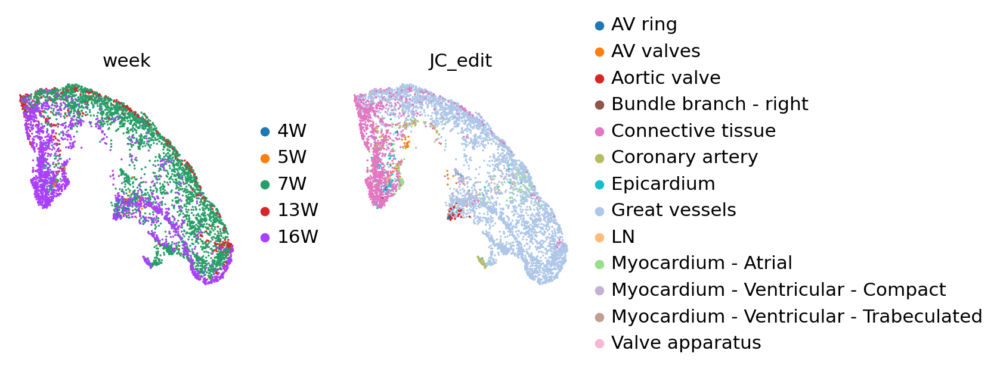

In [54]:
# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['week','JC_edit'], size=10,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=14, frameon=False, components='all')

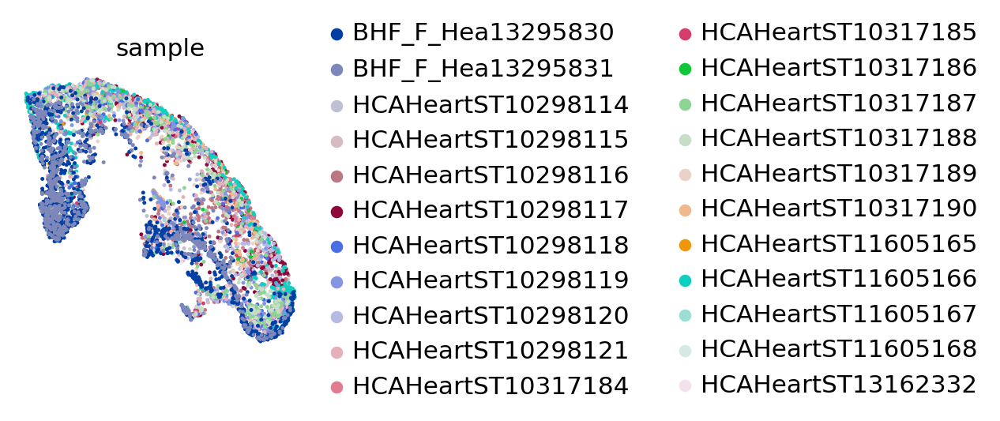

In [55]:
# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['sample'], size=20,
               color_map = 'RdPu', ncols = 3, wspace=0.2,
               legend_fontsize=14, frameon=False, components='all')

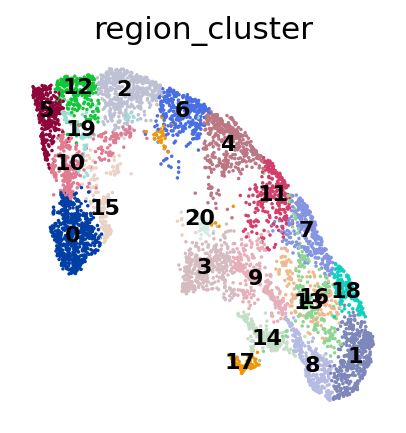

In [56]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['region_cluster'], size=10,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

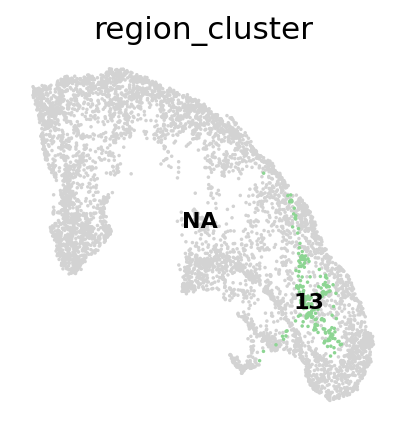

In [57]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['region_cluster'], groups=['13'],size=10,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

##### Atrium #####


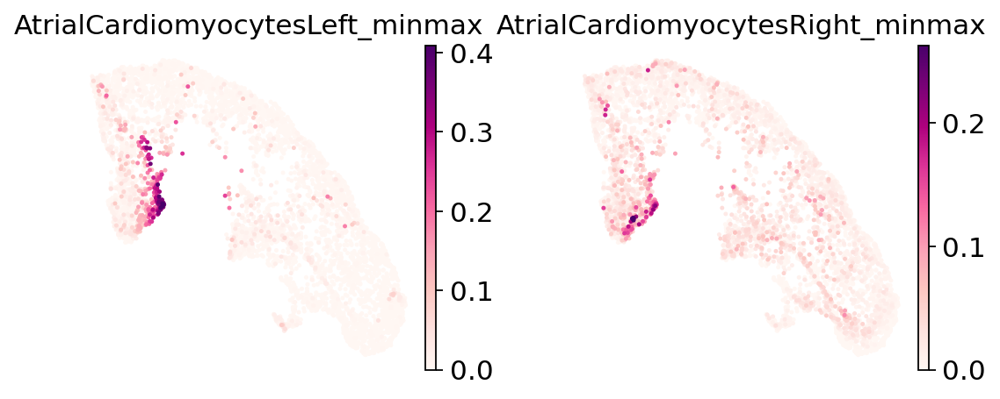

##### Ventricle #####


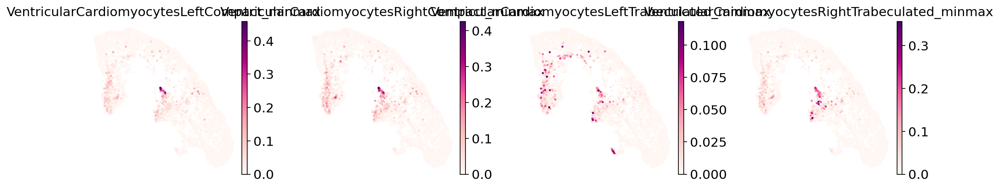

##### CCS #####


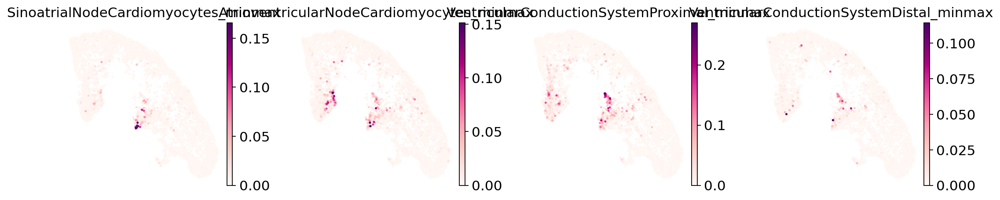

##### Adventitia #####


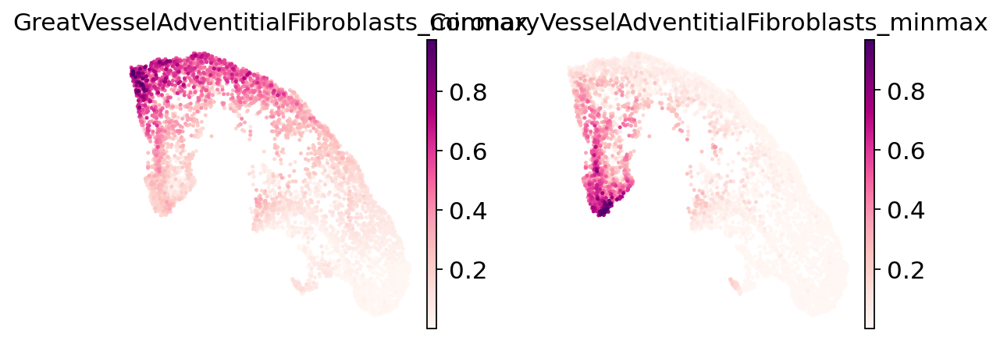

##### LN #####


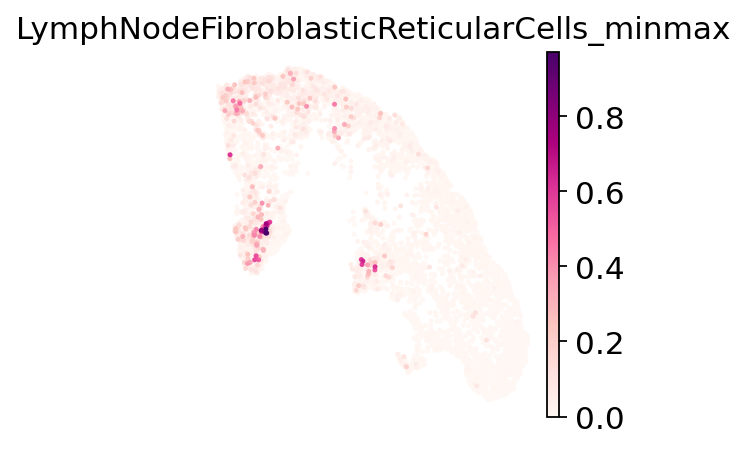

##### Valve #####


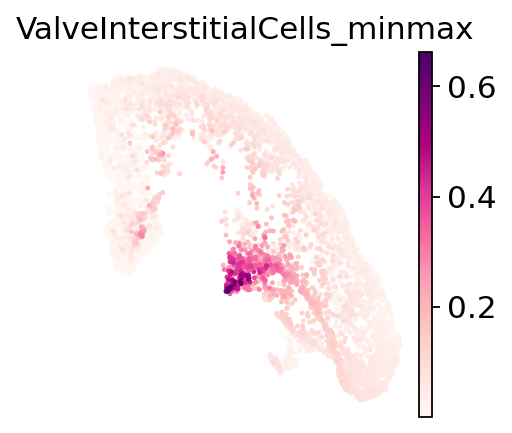

##### Endocardium #####


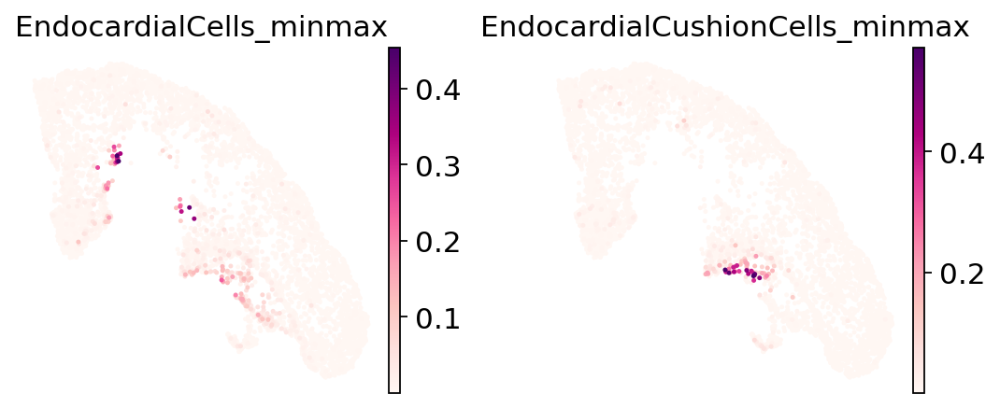

##### Epicardium #####


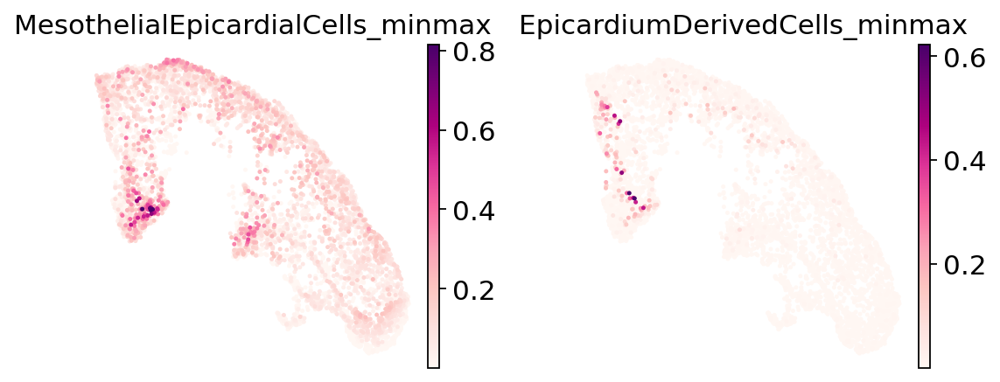

##### DuctusArteriosus #####


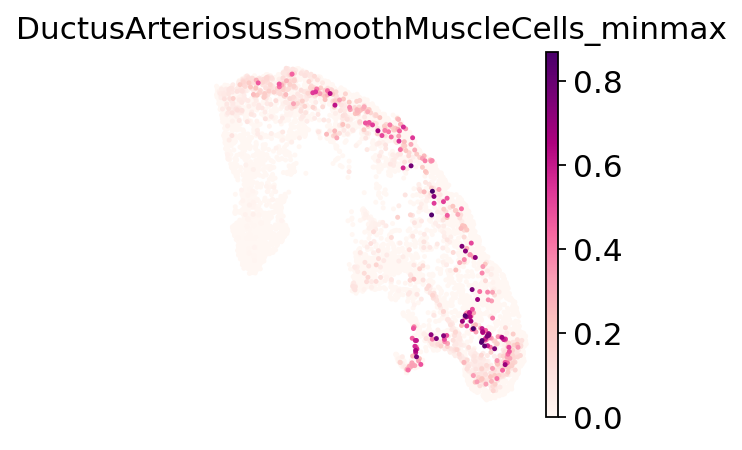

##### Vessels #####


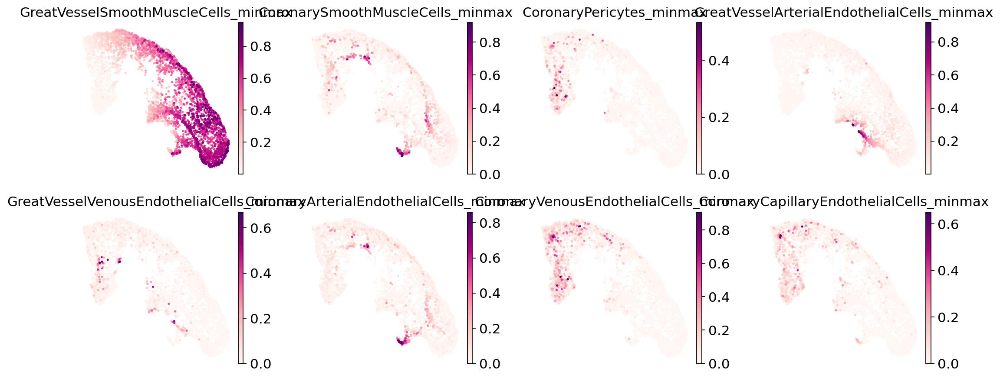

In [58]:
for structure,celltypes in celltypes_for_annotation.items():
    print(f'##### {structure} #####')
    with mpl.rc_context({'axes.facecolor':  'white',
                         'figure.figsize': [3, 3]}):
        sc.pl.umap(adata_sub, color=[f'{x}_minmax' for x in celltypes], size=20,
                   color_map = 'RdPu', ncols = 4, wspace=0.3, vmax='p99.98',
                   legend_fontsize=14, frameon=False)

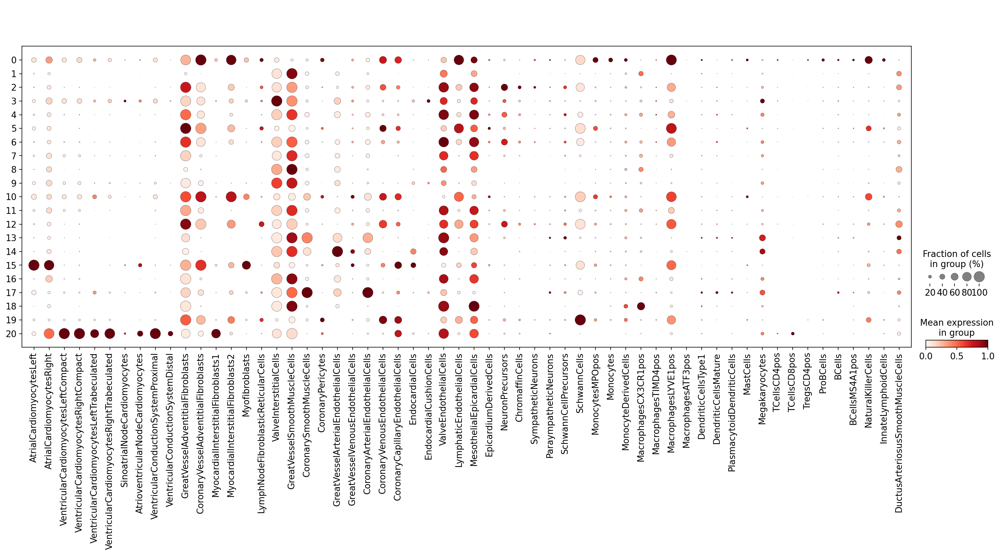

In [59]:
adata_sub.var_names_make_unique()
sc.pl.dotplot(adata_sub,
              cellnames, 
              groupby='region_cluster',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

In [60]:
adata_sub.obs['annotation'] = adata_sub.obs['region_cluster']
adata_sub.obs['annotation'] = adata_sub.obs['annotation'].astype('str')
adata_sub.obs.replace({'annotation': {
    '0': 'Adventitia - Coronary', 
    '1': 'Great vessel', 
    '2': 'Adventitia - GV', 
    '3': 'tbd - AVring, Valves', 
    '4': 'Great vessel', 
    '5': 'Adventitia - GV', 
    '6': 'Great vessel', 
    '7': 'Great vessel', 
    '8': 'Great vessel', 
    '9': 'Great vessel', 
    '10': 'Adventitia - Coronary', 
    '11': 'Great vessel', 
    '12': 'Adventitia - GV', 
    '13': 'Great vessel', 
    '14': 'Great vessel', 
    '15': 'Atrium - Left', 
    '16': 'Great vessel', 
    '17': 'Coronary vessel', 
    '18': 'Great vessel', 
    '19': 'Coronary vessel', 
    '20': 'tbd - Ventricle', 
}}, inplace=True)

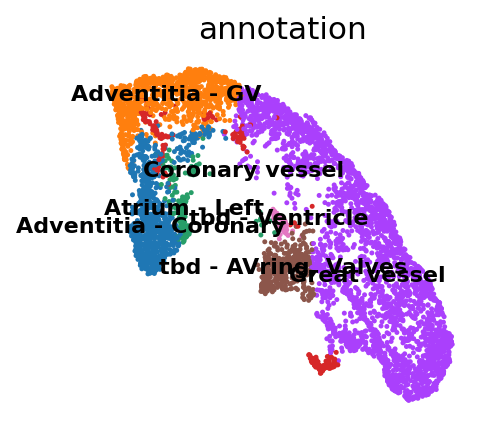

In [61]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['annotation'], size=20,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=10, frameon=False, legend_loc='on data')

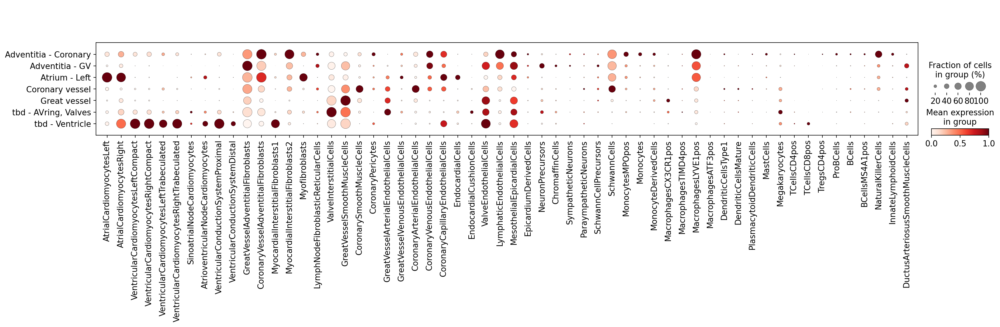

In [62]:
adata_sub.var_names_make_unique()
sc.pl.dotplot(adata_sub,
              cellnames, 
              groupby='annotation',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

In [63]:
# get annotation
annot_df['Vessels_annotation'] = adata_sub.obs['annotation'].reindex(annot_df.index)
annot_df.head()

,global_annotation,myocardium_annotation,CCS-Valve_annotation,Atrium_annotation,Vessels_annotation
spot_id,,,,,
HCAHeartST10298114_AAACAAGTATCTCCCA-1,Ventricle,Endocardium - Ventricular,NaN,NaN,NaN
HCAHeartST10298114_AAACATTTCCCGGATT-1,Ventricle,tbd - Ventricle,NaN,NaN,NaN
HCAHeartST10298114_AAACGAGACGGTTGAT-1,Ventricle,Ventricle - Compact - Right,NaN,NaN,NaN
HCAHeartST10298114_AAACTCGTGATATAAG-1,Vessels,NaN,NaN,NaN,Great vessel
HCAHeartST10298114_AAACTGCTGGCTCCAA-1,Ventricle,Ventricle - Compact - Right,NaN,NaN,NaN


# Subset and re-integration - Node cells

In [64]:
structures = ['tbd - Nodes']

# get index
indices = list(annot_df.index[(annot_df['CCS-Valve_annotation'].isin(structures))|(annot_df['Atrium_annotation'].isin(structures))])
indices = list(set(indices))

In [65]:
# subset
adata_sub = adata_vis[indices]

# # compute KNN using the cell2location output stored in adata.obsm
# bbknn
bbknn.bbknn(adata_sub, batch_key='donor', use_rep='q05_cell_abundance_w_sf_ndarray')

# Cluster spots into regions using scanpy
sc.tl.leiden(adata_sub, resolution=1)

# add region as categorical variable
adata_sub.obs["region_cluster"] = adata_sub.obs["leiden"].astype("category")

# compute UMAP using KNN graph based on the cell2location output
sc.tl.umap(adata_sub, min_dist = 0.2, spread = 1, n_components=3)  # n_components=3

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:179: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  ovld.data[key] = neighbors
/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


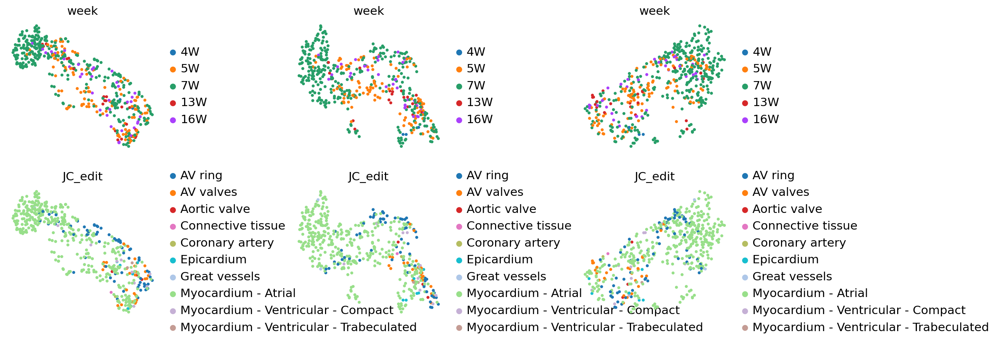

In [66]:
# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['week','JC_edit'], size=50,
               color_map = 'RdPu', ncols = 3, wspace=0.7,
               legend_fontsize=14, frameon=False, components='all')

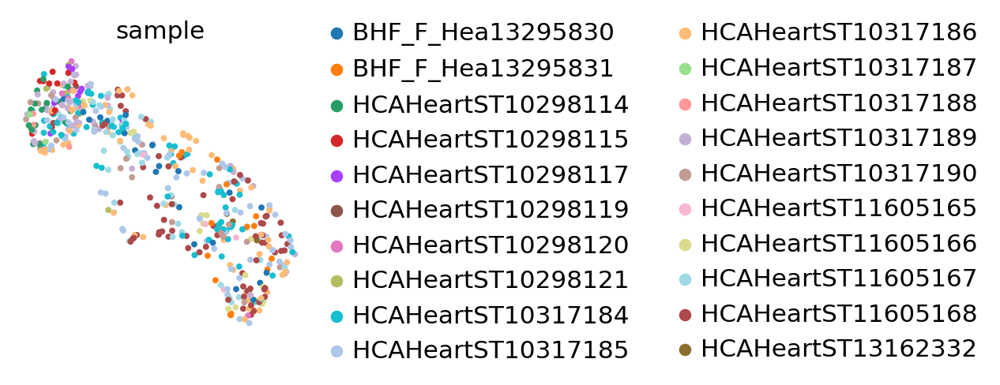

In [67]:
# show regions in UMAP coordinates
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['sample'], size=50,
               color_map = 'RdPu', ncols = 3, wspace=0.2,
               legend_fontsize=14, frameon=False, components='1,2')

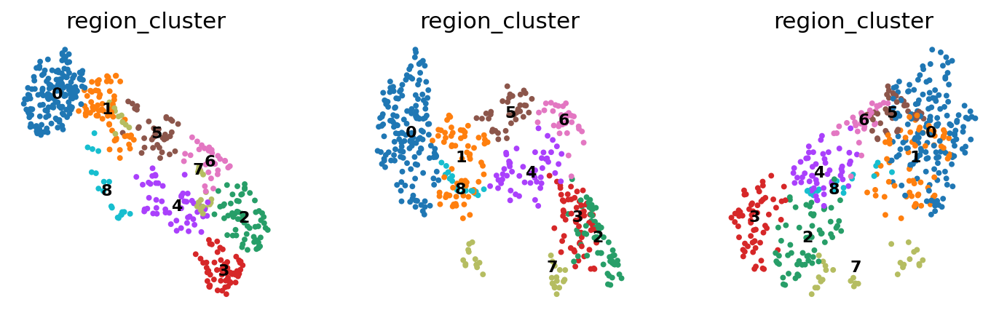

In [72]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['region_cluster'], size=50,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

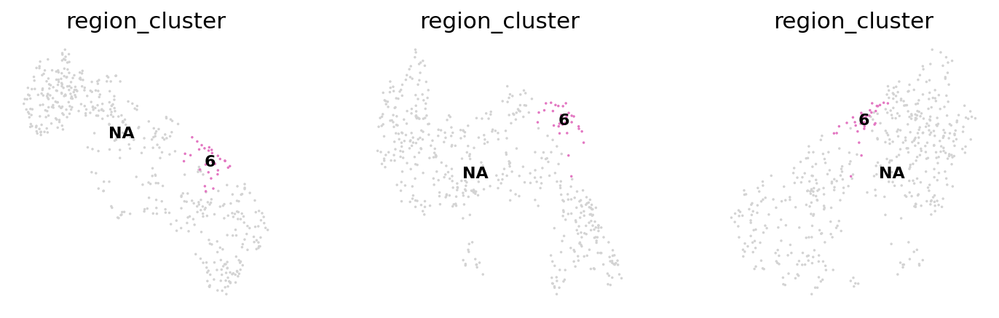

In [69]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['region_cluster'], groups=['6'],size=10,
               color_map = 'RdPu', ncols = 3, wspace=0.2,legend_loc='on data',
               legend_fontsize=10, frameon=False, components='all')

##### Atrium #####


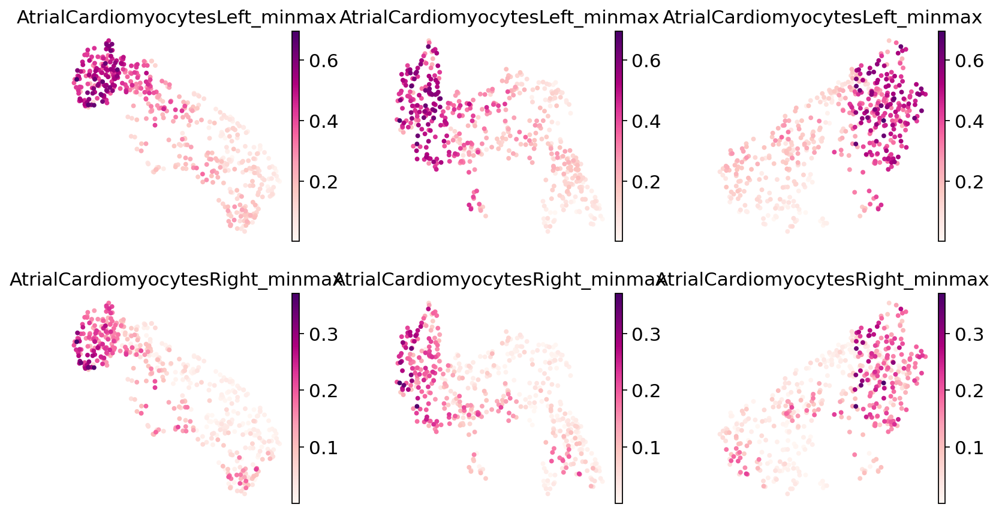

##### Ventricle #####


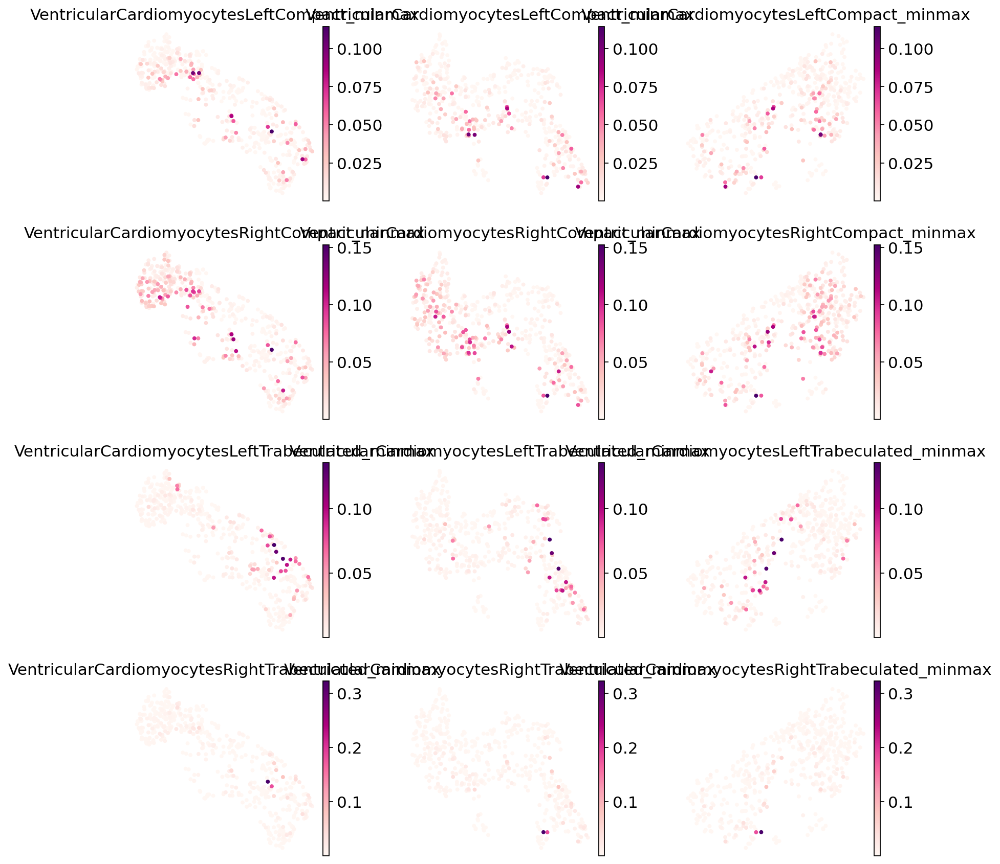

##### CCS #####


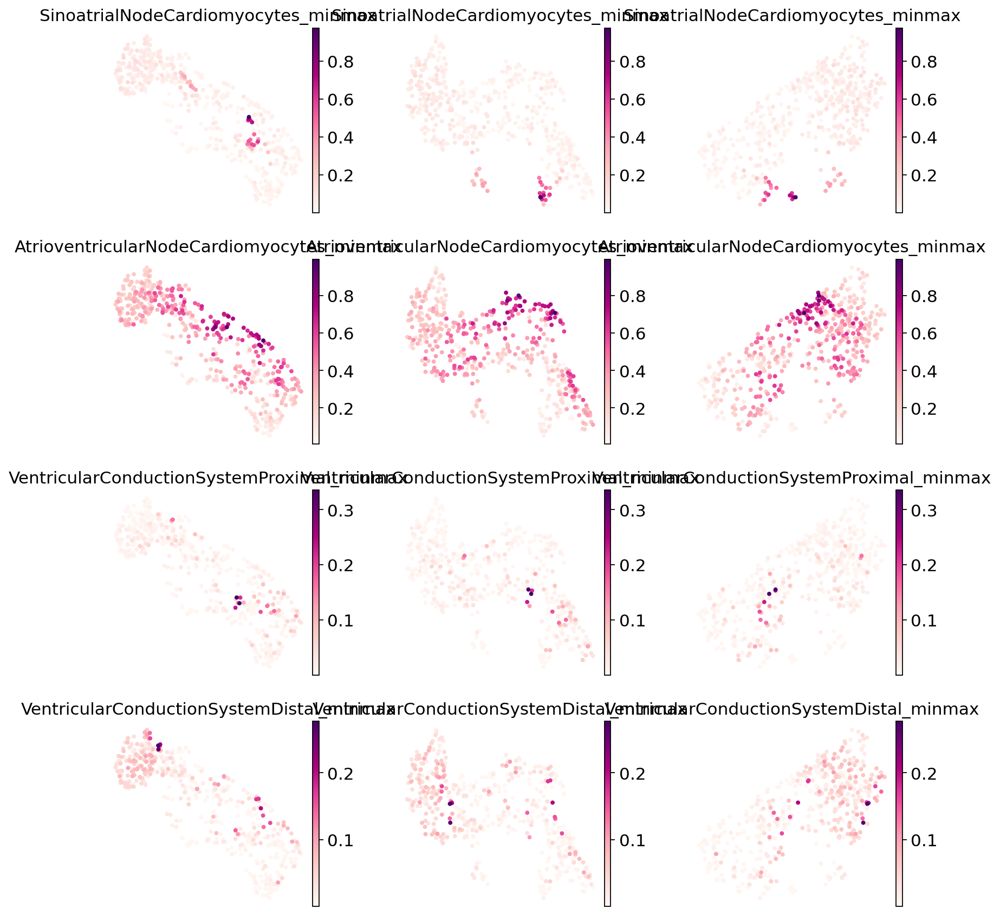

##### Adventitia #####


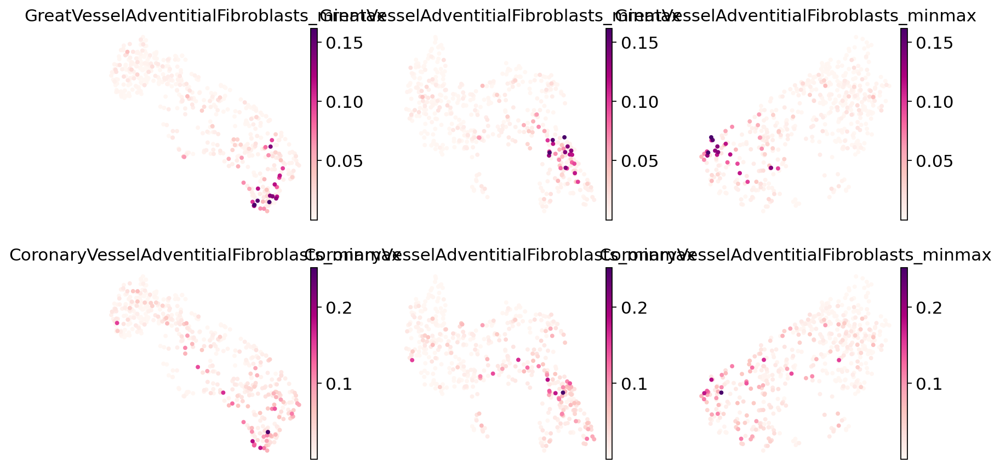

##### LN #####


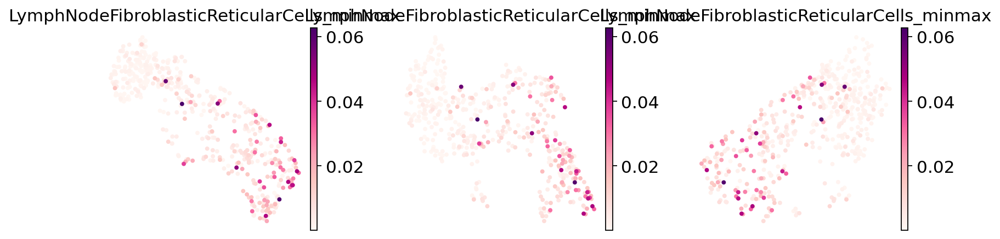

##### Valve #####


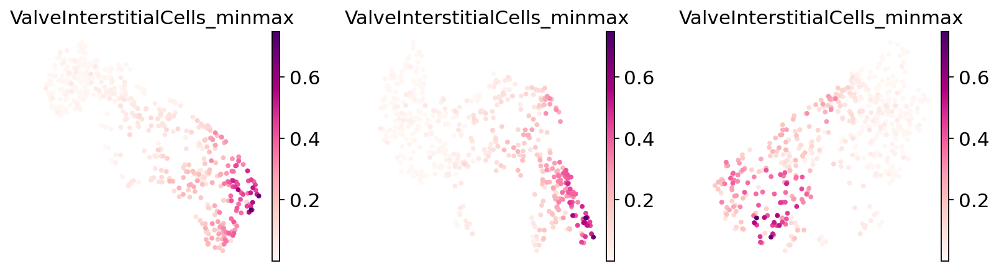

##### Endocardium #####


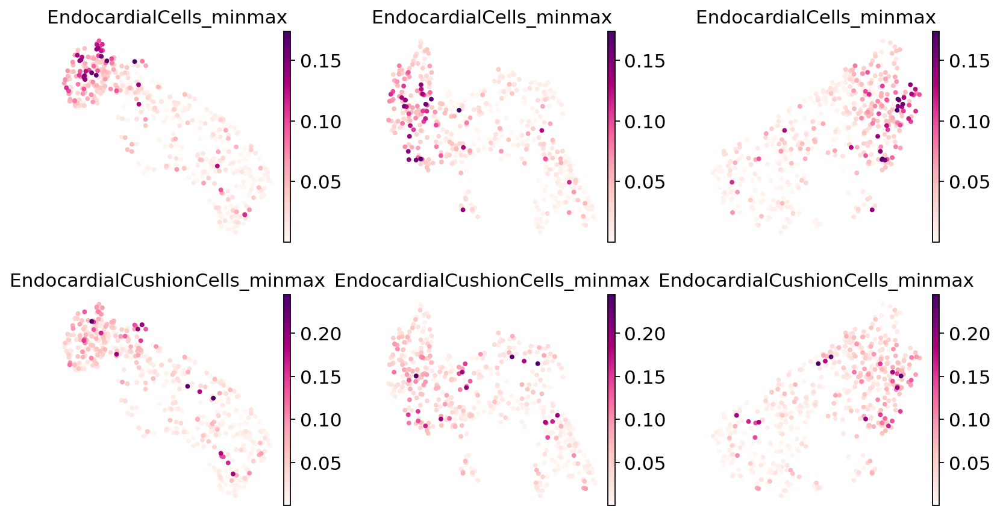

##### Epicardium #####


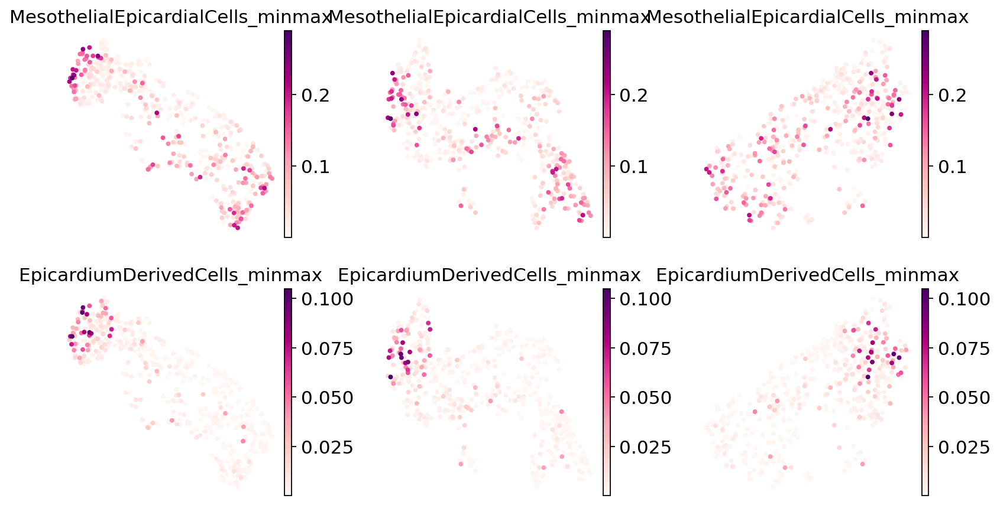

##### DuctusArteriosus #####


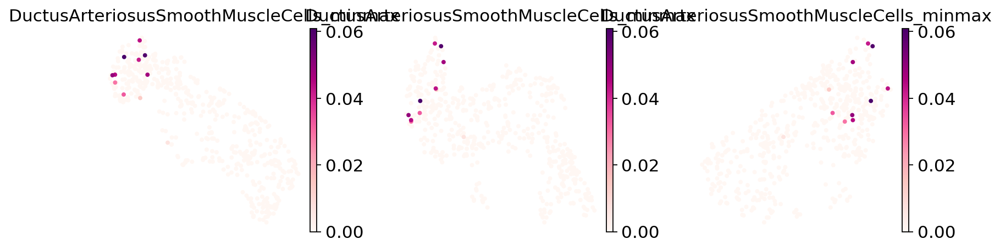

##### Vessels #####


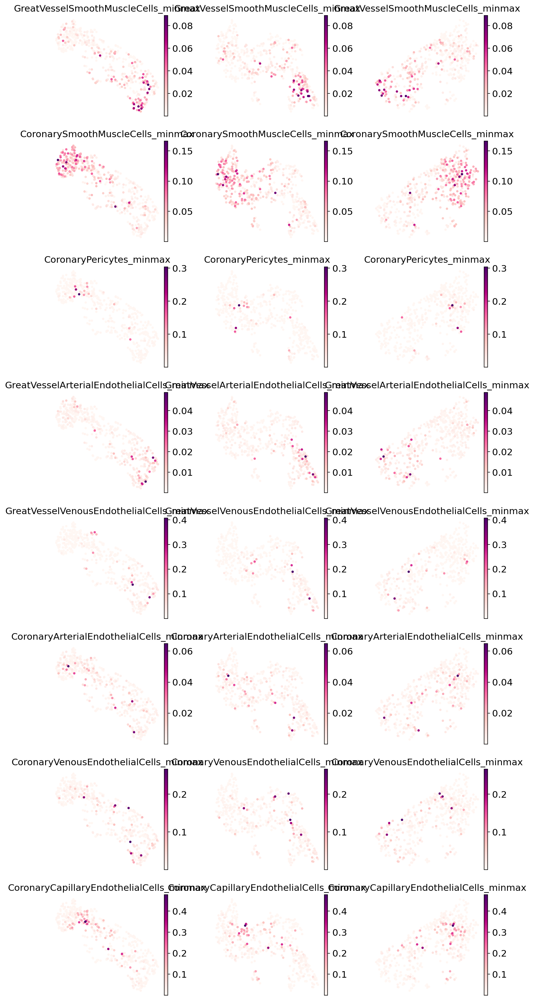

In [70]:
for structure,celltypes in celltypes_for_annotation.items():
    print(f'##### {structure} #####')
    with mpl.rc_context({'axes.facecolor':  'white',
                         'figure.figsize': [3, 3]}):
        sc.pl.umap(adata_sub, color=[f'{x}_minmax' for x in celltypes], size=50,
                   color_map = 'RdPu', ncols = 3, wspace=0.3, vmax='p99.98',
                   legend_fontsize=14, frameon=False, components='all')

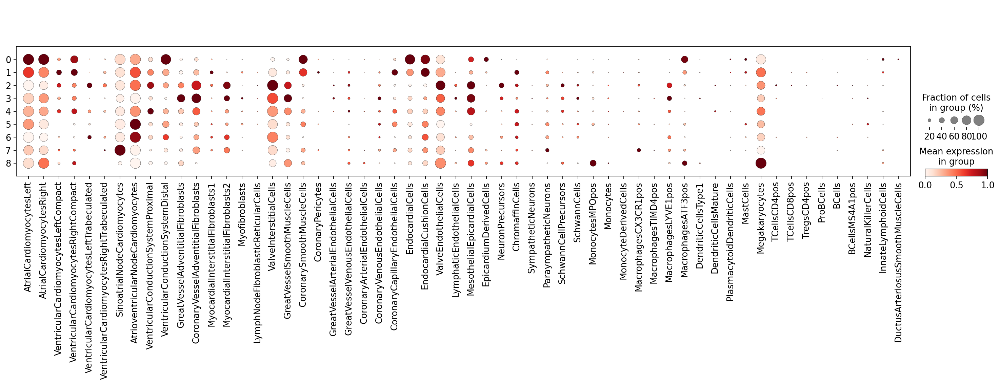

In [71]:
adata_sub.var_names_make_unique()
sc.pl.dotplot(adata_sub,
              cellnames, 
              groupby='region_cluster',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

In [73]:
adata_sub.obs['annotation'] = adata_sub.obs['region_cluster']
adata_sub.obs['annotation'] = adata_sub.obs['annotation'].astype('str')
adata_sub.obs.replace({'annotation': {
    '0': 'Atrium - Left', 
    '1': 'Atrium - Left', 
    '2': 'tbd - AVring, Valves', 
    '3': 'tbd - AVring, Valves', 
    '4': 'VCS - Proximal', 
    '5': 'AVnode', 
    '6': 'AVnode', 
    '7': 'SAnode', 
    '8': 'Atrium - Left', 
}}, inplace=True)

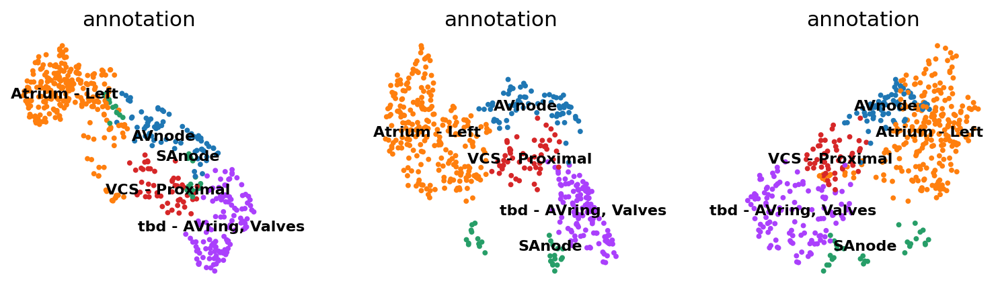

In [74]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [3, 3]}):
    sc.pl.umap(adata_sub, color=['annotation'], size=50,
               color_map = 'RdPu', ncols = 3, wspace=0.3,
               legend_fontsize=10, frameon=False, legend_loc='on data', components='all')

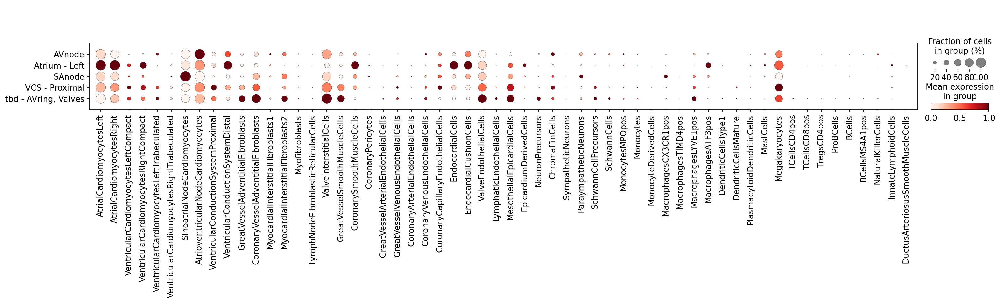

In [75]:
adata_sub.var_names_make_unique()
sc.pl.dotplot(adata_sub,
              cellnames, 
              groupby='annotation',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              expression_cutoff=0.1
             )

In [76]:
# get annotation
annot_df['Nodes_annotation'] = adata_sub.obs['annotation'].reindex(annot_df.index)
annot_df.head()

,global_annotation,myocardium_annotation,CCS-Valve_annotation,Atrium_annotation,Vessels_annotation,Nodes_annotation
spot_id,,,,,,
HCAHeartST10298114_AAACAAGTATCTCCCA-1,Ventricle,Endocardium - Ventricular,NaN,NaN,NaN,NaN
HCAHeartST10298114_AAACATTTCCCGGATT-1,Ventricle,tbd - Ventricle,NaN,NaN,NaN,NaN
HCAHeartST10298114_AAACGAGACGGTTGAT-1,Ventricle,Ventricle - Compact - Right,NaN,NaN,NaN,NaN
HCAHeartST10298114_AAACTCGTGATATAAG-1,Vessels,NaN,NaN,NaN,Great vessel,NaN
HCAHeartST10298114_AAACTGCTGGCTCCAA-1,Ventricle,Ventricle - Compact - Right,NaN,NaN,NaN,NaN


# Annotate based on cell2location estimated abundance

In [77]:
# prepare column
annot_df['cell2loc-abundance_annotation'] = np.nan

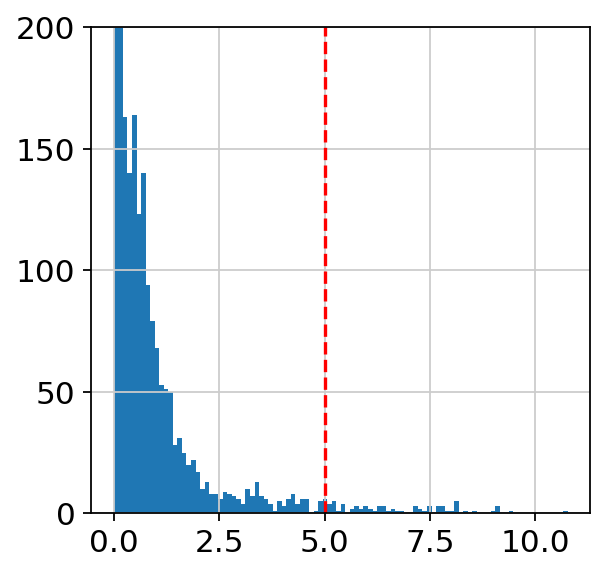

71

In [78]:
# annotate "Ductus arteriosus" based on DuctusArteriosusSMC abuncance
thresh = 5

adata_vis.obs['DuctusArteriosusSmoothMuscleCells'].hist(bins=100)
plt.ylim(0,200)
plt.axvline(x=thresh, color='r', linestyle='--')
plt.show()

obsnames = adata_vis.obs_names[adata_vis.obs['DuctusArteriosusSmoothMuscleCells']>thresh]
annot_df.loc[obsnames,'cell2loc-abundance_annotation'] = 'Ductus arteriosus'

len(obsnames)

In [79]:
annot_df

,global_annotation,myocardium_annotation,CCS-Valve_annotation,Atrium_annotation,Vessels_annotation,Nodes_annotation,cell2loc-abundance_annotation
spot_id,,,,,,,
HCAHeartST10298114_AAACAAGTATCTCCCA-1,Ventricle,Endocardium - Ventricular,NaN,NaN,NaN,NaN,NaN
HCAHeartST10298114_AAACATTTCCCGGATT-1,Ventricle,tbd - Ventricle,NaN,NaN,NaN,NaN,NaN
HCAHeartST10298114_AAACGAGACGGTTGAT-1,Ventricle,Ventricle - Compact - Right,NaN,NaN,NaN,NaN,NaN
HCAHeartST10298114_AAACTCGTGATATAAG-1,Vessels,NaN,NaN,NaN,Great vessel,NaN,NaN
HCAHeartST10298114_AAACTGCTGGCTCCAA-1,Ventricle,Ventricle - Compact - Right,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
BHF_F_Hea13295831_TGTTGGTGATTAGGTA-1,Ventricle,Ventricle - Compact - Left,NaN,NaN,NaN,NaN,NaN
BHF_F_Hea13295831_TGTTGGTGCGCACGAG-1,Ventricle,Ventricle - Trabeculated - Right,NaN,NaN,NaN,NaN,NaN
BHF_F_Hea13295831_TGTTGGTGCGCTTCGC-1,Ventricle,tbd - Ventricle,NaN,NaN,NaN,NaN,NaN


# Collect all annotations so far

In [80]:
annotation_final = []
for ind in annot_df.index:
    l = list(annot_df.loc[ind,['myocardium_annotation', 'CCS-Valve_annotation',
                                   'Atrium_annotation', 'Vessels_annotation', 'Nodes_annotation',
                                   'cell2loc-abundance_annotation']])
    l = [x for x in l if x==x]
    if len(l)>0:
        ll = [x for x in l if 'tbd -' not in x]
        if len(ll)==1:
            annotation_final.append(ll[0])
        # elif l[-1]=='Epicardium':
        #     annotation_final.append(l[-1])
        elif l[-1]=='Ductus arteriosus':
            annotation_final.append(l[-1])
        else:
            annotation_final.append(' | '.join(l))
    else:
        annotation_final.append(np.nan)
        
annot_df['pre-final'] = annotation_final.copy()
annot_df.head()

,global_annotation,myocardium_annotation,CCS-Valve_annotation,Atrium_annotation,Vessels_annotation,Nodes_annotation,cell2loc-abundance_annotation,pre-final
spot_id,,,,,,,,
HCAHeartST10298114_AAACAAGTATCTCCCA-1,Ventricle,Endocardium - Ventricular,NaN,NaN,NaN,NaN,NaN,Endocardium - Ventricular
HCAHeartST10298114_AAACATTTCCCGGATT-1,Ventricle,tbd - Ventricle,NaN,NaN,NaN,NaN,NaN,tbd - Ventricle
HCAHeartST10298114_AAACGAGACGGTTGAT-1,Ventricle,Ventricle - Compact - Right,NaN,NaN,NaN,NaN,NaN,Ventricle - Compact - Right
HCAHeartST10298114_AAACTCGTGATATAAG-1,Vessels,NaN,NaN,NaN,Great vessel,NaN,NaN,Great vessel
HCAHeartST10298114_AAACTGCTGGCTCCAA-1,Ventricle,Ventricle - Compact - Right,NaN,NaN,NaN,NaN,NaN,Ventricle - Compact - Right


In [81]:
set(annot_df['pre-final'])

{'AVnode',
 'Adventitia - Coronary',
 'Adventitia - GV',
 'Atrium - Left',
 'Atrium - Right',
 'Coronary vessel',
 'Ductus arteriosus',
 'Endocardial cusion',
 'Endocardium - Atrial',
 'Endocardium - Ventricular',
 'Great vessel',
 'SAnode',
 'Uncertain',
 'VCS - Distal',
 'VCS - Proximal',
 'Ventricle - Compact - Left',
 'Ventricle - Compact - Right',
 'Ventricle - Trabeculated - Left',
 'Ventricle - Trabeculated - Right',
 'tbd - AVring, Valves',
 'tbd - CCS, Valves | tbd - AVring, Valves',
 'tbd - CCS, Valves | tbd - Nodes | tbd - AVring, Valves',
 'tbd - Ventricle'}

In [82]:
# rename some of them
annot_df.replace({'pre-final':{
    'tbd - CCS, Valves | tbd - AVring, Valves':'tbd - AVring, Valves',
    'tbd - CCS, Valves | tbd - Nodes | tbd - AVring, Valves':'tbd - AVring, Valves',
    'tbd - Atrium - Left | tbd - Nodes | tbd - AVring, Valves':'tbd - AVring, Valves'
}},inplace=True)
set(annot_df['pre-final'])

{'AVnode',
 'Adventitia - Coronary',
 'Adventitia - GV',
 'Atrium - Left',
 'Atrium - Right',
 'Coronary vessel',
 'Ductus arteriosus',
 'Endocardial cusion',
 'Endocardium - Atrial',
 'Endocardium - Ventricular',
 'Great vessel',
 'SAnode',
 'Uncertain',
 'VCS - Distal',
 'VCS - Proximal',
 'Ventricle - Compact - Left',
 'Ventricle - Compact - Right',
 'Ventricle - Trabeculated - Left',
 'Ventricle - Trabeculated - Right',
 'tbd - AVring, Valves',
 'tbd - Ventricle'}

# Refine annotations (with using manual annotations)

In [83]:
# add manual annotation
annot_df['JC_edit'] = adata_vis.obs['JC_edit'].reindex(annot_df.index)
annot_df.head()

,global_annotation,myocardium_annotation,CCS-Valve_annotation,Atrium_annotation,Vessels_annotation,Nodes_annotation,cell2loc-abundance_annotation,pre-final,JC_edit
spot_id,,,,,,,,,
HCAHeartST10298114_AAACAAGTATCTCCCA-1,Ventricle,Endocardium - Ventricular,NaN,NaN,NaN,NaN,NaN,Endocardium - Ventricular,Myocardium - Ventricular - Trabeculated
HCAHeartST10298114_AAACATTTCCCGGATT-1,Ventricle,tbd - Ventricle,NaN,NaN,NaN,NaN,NaN,tbd - Ventricle,Myocardium - Ventricular - Compact
HCAHeartST10298114_AAACGAGACGGTTGAT-1,Ventricle,Ventricle - Compact - Right,NaN,NaN,NaN,NaN,NaN,Ventricle - Compact - Right,Myocardium - Ventricular - Trabeculated
HCAHeartST10298114_AAACTCGTGATATAAG-1,Vessels,NaN,NaN,NaN,Great vessel,NaN,NaN,Great vessel,Great vessels
HCAHeartST10298114_AAACTGCTGGCTCCAA-1,Ventricle,Ventricle - Compact - Right,NaN,NaN,NaN,NaN,NaN,Ventricle - Compact - Right,Myocardium - Ventricular - Compact


In [84]:
# cross table
pd.crosstab(annot_df['pre-final'],annot_df['JC_edit'])

JC_edit,AV ring,AV valves,AVN,Aortic valve,Bundle branch - left,Bundle branch - right,Connective tissue,Coronary artery,Epicardium,Great vessels,LN,Myocardium - Atrial,Myocardium - Papillary Muscle,Myocardium - Ventricular - Compact,Myocardium - Ventricular - Trabeculated,Valve apparatus
pre-final,,,,,,,,,,,,,,,,
AVnode,27,2,0,0,0,0,0,0,0,0,0,37,0,3,0,0
Adventitia - Coronary,22,26,0,4,0,1,858,93,462,37,11,530,0,228,10,1
Adventitia - GV,0,0,0,0,0,0,466,2,2,648,0,4,0,0,0,0
Atrium - Left,23,52,0,0,0,0,71,5,15,23,0,2258,0,1,0,1
Atrium - Right,0,0,0,0,0,0,4,0,14,0,0,919,0,2,1,0
Coronary vessel,0,0,0,0,0,0,89,42,1,105,0,3,0,1,0,0
Ductus arteriosus,0,0,0,0,0,0,0,0,0,71,0,0,0,0,0,0
Endocardial cusion,11,53,0,20,0,0,0,0,0,19,0,1,1,3,13,96
Endocardium - Atrial,0,1,0,0,0,0,0,0,0,3,0,451,0,0,0,0


In [85]:
# prepare column
annot_df['final'] = annot_df['pre-final'].copy()

### Fully dependent on manual annotation

* AVN
* LN
* Epicardium

In [86]:
# AVN
obsnames = annot_df.index[annot_df['JC_edit']=='AVN']
annot_df.loc[obsnames,'final'] = 'AVnode'
# LN
obsnames = annot_df.index[annot_df['JC_edit']=='LN']
annot_df.loc[obsnames,'final'] = 'LN'
# Epicardium
obsnames = annot_df.index[annot_df['JC_edit']=='Epicardium']
annot_df.loc[obsnames,'final'] = 'Epicardium'

### Partly dependent on manual annotation

* AV ring
* AV valves
* Aortic valve
* Valve apparatus
* Epicardium
* Coronary artery
* Great vessels

if "pre-final" is 'tbd -' or 'Uncertain', then use manual annotation

In [87]:
annots = ['AV ring','AV valves','Aortic valve','Valve apparatus','Epicardium','Coronary artery','Great vessels','Connective tissue']
for anno in annots:
    obsnames = annot_df.index[(annot_df['JC_edit']==anno)&\
                              ([('tbd -' in x)|(x=='Uncertain') for x in annot_df['pre-final']])]
                              
    print(f'{anno}, n_spot to modify: {len(obsnames)}')
    if anno=='Connective tissue':
        annot_df.loc[obsnames,'final'] = 'AV ring'
    else:
        annot_df.loc[obsnames,'final'] = anno

AV ring, n_spot to modify: 343
AV valves, n_spot to modify: 421
Aortic valve, n_spot to modify: 229
Valve apparatus, n_spot to modify: 205
Epicardium, n_spot to modify: 128
Coronary artery, n_spot to modify: 4
Great vessels, n_spot to modify: 518
Connective tissue, n_spot to modify: 7


### Coronary vessel vs Great vessel

Overwrite "coronary vessel" spots ("pre-final") which were manualy annotated as "Great vessels"

In [88]:
obsnames = annot_df.index[(annot_df['pre-final']=='Coronary vessel')&\
                          (annot_df['JC_edit']=='Great vessels')]
                              
print(f'n_spot to modify: {len(obsnames)}')
annot_df.loc[obsnames,'final'] = 'Great vessel'

n_spot to modify: 105


### Myocardium Atrial

* Determine Left or Right

128


/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


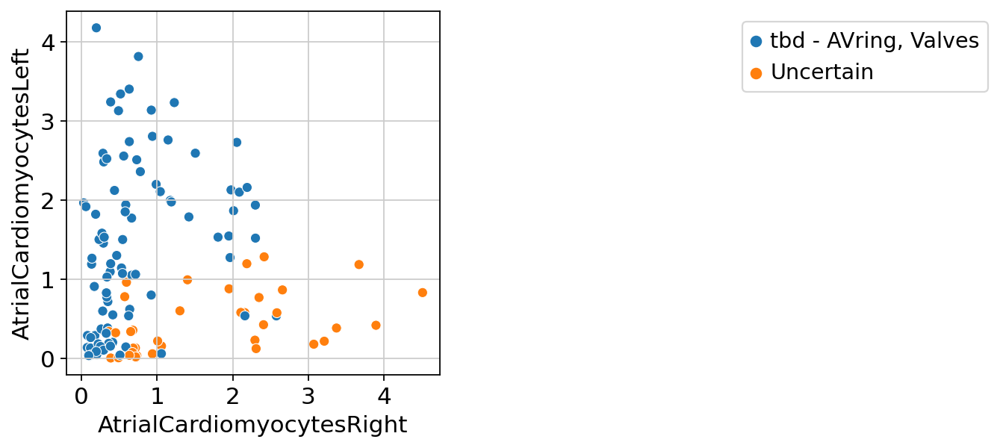

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


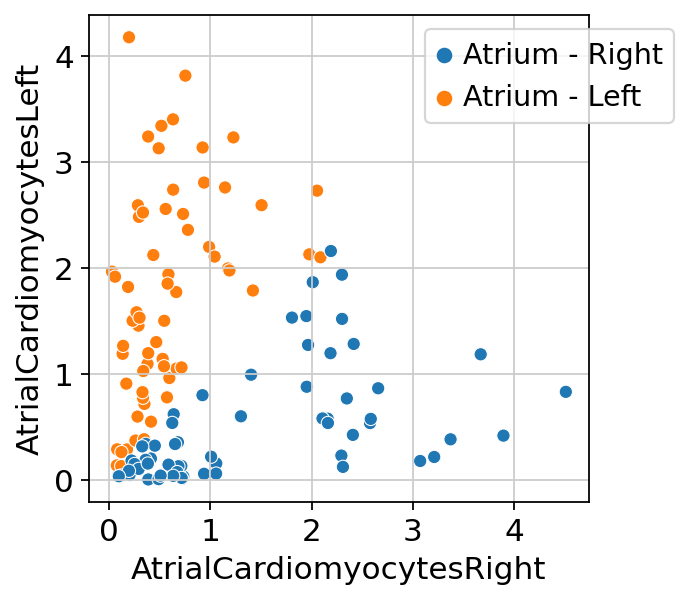

In [89]:
obsnames = annot_df.index[(annot_df['JC_edit']=='Myocardium - Atrial')&\
                              ([('tbd -' in x)|(x=='Uncertain') for x in annot_df['pre-final']])]
print(len(obsnames))
ad = adata_vis[obsnames].copy()
sns.scatterplot(ad.obs['AtrialCardiomyocytesRight'],ad.obs['AtrialCardiomyocytesLeft'],
                hue=annot_df.loc[obsnames,'final'])
plt.legend(loc='upper right',bbox_to_anchor=(2.5, 1))
plt.show()

# decide right or left based on cell2loc abundance
df = ad.obs.loc[obsnames,['AtrialCardiomyocytesRight','AtrialCardiomyocytesLeft']]
df['annotation'] = 'Atrium - Left'
obsnames_right = df.index[df['AtrialCardiomyocytesRight']>df['AtrialCardiomyocytesLeft']]
df.loc[obsnames_right,'annotation'] = 'Atrium - Right'

# add annotation
annot_df.loc[obsnames,'final'] = df['annotation'].copy()

sns.scatterplot(ad.obs['AtrialCardiomyocytesRight'],ad.obs['AtrialCardiomyocytesLeft'],
                hue=annot_df.loc[obsnames,'final'])
plt.legend(loc='upper right',bbox_to_anchor=(1.2, 1))
plt.show()

### Myocardium Ventricular - Compact

* Determine Left or Right

2229


/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


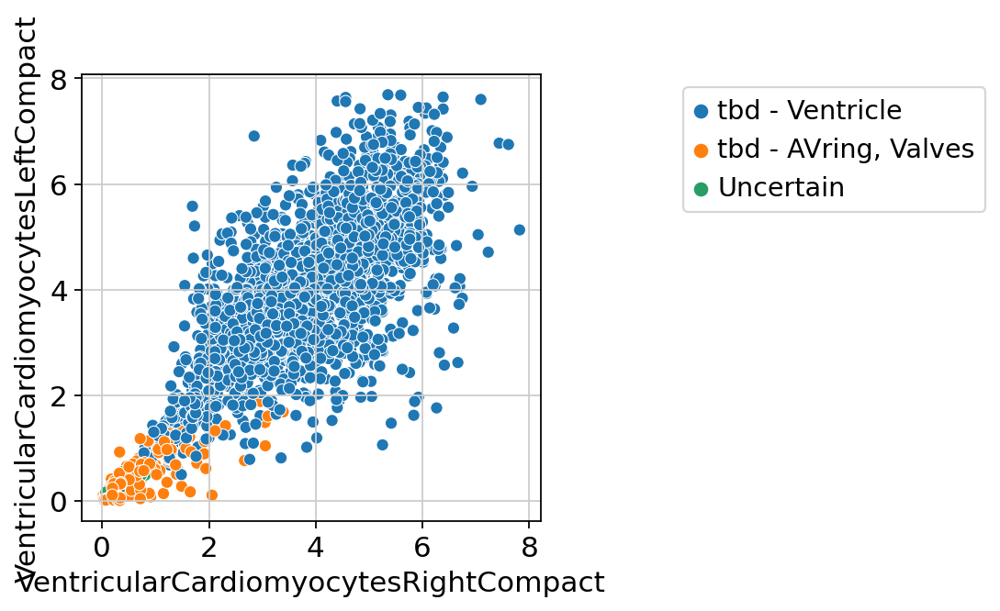

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


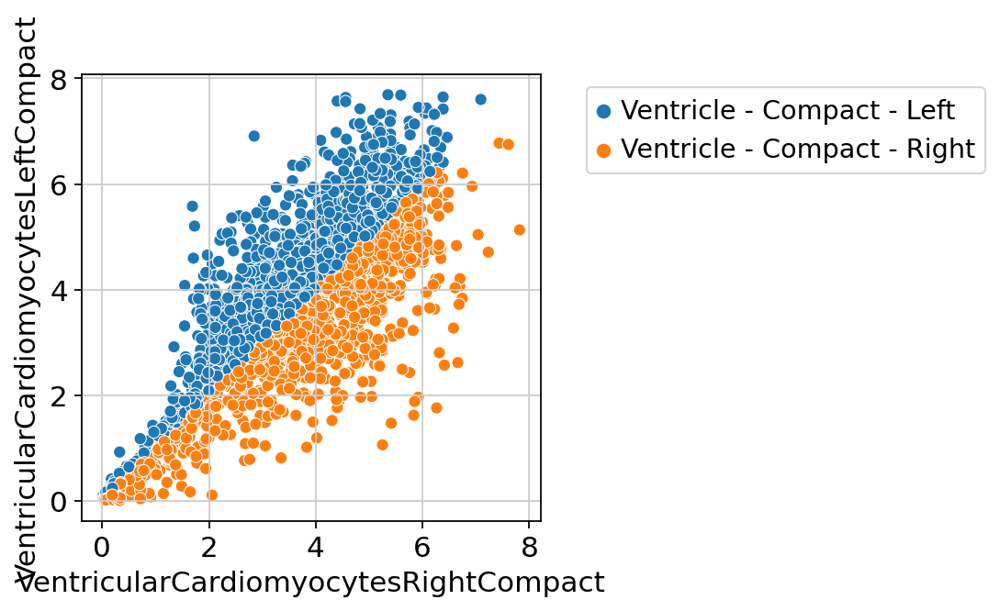

In [90]:
obsnames = annot_df.index[(annot_df['JC_edit']=='Myocardium - Ventricular - Compact')&\
                              ([('tbd -' in x)|(x=='Uncertain') for x in annot_df['pre-final']])]
print(len(obsnames))
ad = adata_vis[obsnames].copy()
sns.scatterplot(ad.obs['VentricularCardiomyocytesRightCompact'],ad.obs['VentricularCardiomyocytesLeftCompact'],
                hue=annot_df.loc[obsnames,'pre-final'])
plt.legend(loc='upper right',bbox_to_anchor=(2, 1))
plt.show()

# decide right or left based on cell2loc abundance
df = ad.obs.loc[obsnames,['VentricularCardiomyocytesRightCompact','VentricularCardiomyocytesLeftCompact']]
df['annotation'] = 'Ventricle - Compact - Left'
obsnames_right = df.index[df['VentricularCardiomyocytesRightCompact']>df['VentricularCardiomyocytesLeftCompact']]
df.loc[obsnames_right,'annotation'] = 'Ventricle - Compact - Right'

# add annotation
annot_df.loc[obsnames,'final'] = df['annotation'].copy()

sns.scatterplot(ad.obs['VentricularCardiomyocytesRightCompact'],ad.obs['VentricularCardiomyocytesLeftCompact'],
                hue=annot_df.loc[obsnames,'final'])
plt.legend(loc='upper right',bbox_to_anchor=(2, 1))
plt.show()

### Myocardium Ventricular - Trabeculated

* Determine Left or Right

1113


/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


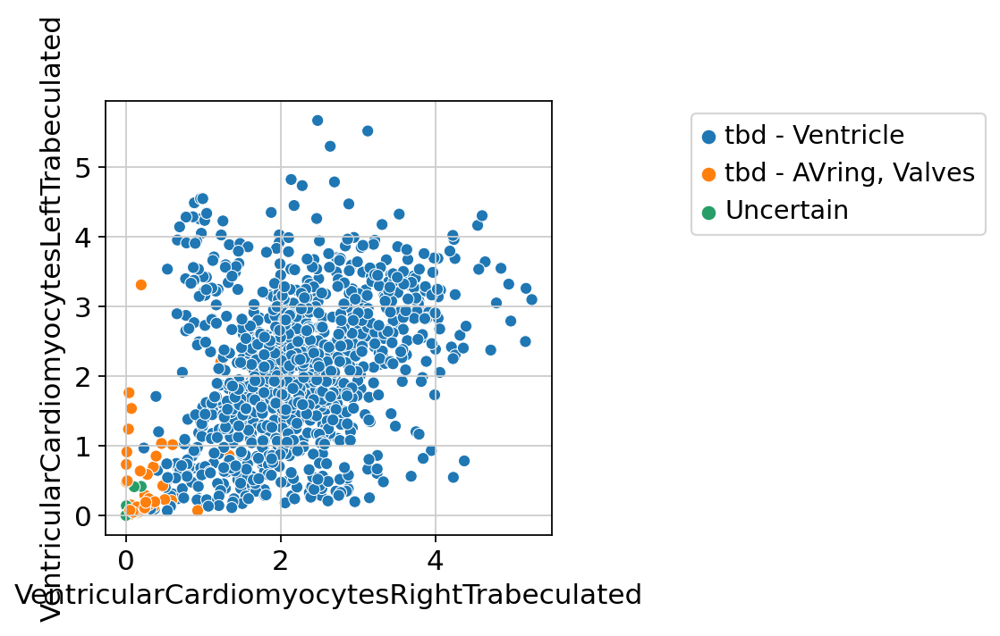

/home/jovyan/my-conda-envs/cellpymc/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


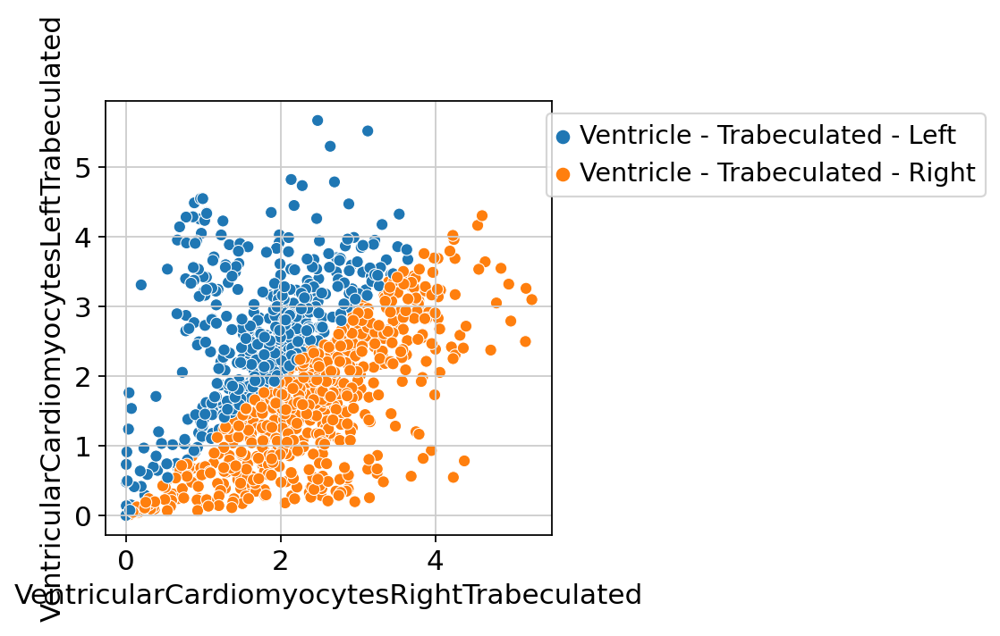

In [91]:
obsnames = annot_df.index[(annot_df['JC_edit'].isin(['Myocardium - Papillary Muscle',
                                                     'Myocardium - Ventricular - Trabeculated',
                                                     'Bundle branch - left','Bundle branch - right'
                                                    ]))&\
                              ([('tbd -' in x)|(x=='Uncertain') for x in annot_df['pre-final']])]
print(len(obsnames))
ad = adata_vis[obsnames].copy()
sns.scatterplot(ad.obs['VentricularCardiomyocytesRightTrabeculated'],ad.obs['VentricularCardiomyocytesLeftTrabeculated'],
                hue=annot_df.loc[obsnames,'pre-final'])
plt.legend(loc='upper right',bbox_to_anchor=(2, 1))
plt.show()

# decide right or left based on cell2loc abundance
df = ad.obs.loc[obsnames,['VentricularCardiomyocytesRightTrabeculated','VentricularCardiomyocytesLeftTrabeculated']]
df['annotation'] = 'Ventricle - Trabeculated - Left'
obsnames_right = df.index[df['VentricularCardiomyocytesRightTrabeculated']>df['VentricularCardiomyocytesLeftTrabeculated']]
df.loc[obsnames_right,'annotation'] = 'Ventricle - Trabeculated - Right'

# add annotation
annot_df.loc[obsnames,'final'] = df['annotation'].copy()

sns.scatterplot(ad.obs['VentricularCardiomyocytesRightTrabeculated'],ad.obs['VentricularCardiomyocytesLeftTrabeculated'],
                hue=annot_df.loc[obsnames,'final'])
plt.legend(loc='upper right',bbox_to_anchor=(2, 1))
plt.show()

In [92]:
# refine name
annot_df.replace({'final':{
    'Coronary artery':'Coronary vessel',
    'Endocardium - Atrial':'Endocardium',
    'Endocardium - Ventricular':'Endocardium',
    'Epicardium - Atrial':'Epicardium',
    'Epicardium - Ventricular':'Epicardium',
    'Great vessels':'Great vessel',
}},inplace=True)
set(annot_df['final'])

{'AV ring',
 'AV valves',
 'AVnode',
 'Adventitia - Coronary',
 'Adventitia - GV',
 'Aortic valve',
 'Atrium - Left',
 'Atrium - Right',
 'Coronary vessel',
 'Ductus arteriosus',
 'Endocardial cusion',
 'Endocardium',
 'Epicardium',
 'Great vessel',
 'LN',
 'SAnode',
 'VCS - Distal',
 'VCS - Proximal',
 'Valve apparatus',
 'Ventricle - Compact - Left',
 'Ventricle - Compact - Right',
 'Ventricle - Trabeculated - Left',
 'Ventricle - Trabeculated - Right'}

In [93]:
# cross table
pd.crosstab(annot_df['final'],annot_df['JC_edit'])

JC_edit,AV ring,AV valves,AVN,Aortic valve,Bundle branch - left,Bundle branch - right,Connective tissue,Coronary artery,Epicardium,Great vessels,LN,Myocardium - Atrial,Myocardium - Papillary Muscle,Myocardium - Ventricular - Compact,Myocardium - Ventricular - Trabeculated,Valve apparatus
final,,,,,,,,,,,,,,,,
AV ring,343,0,0,0,0,0,7,0,0,0,0,0,0,0,0,0
AV valves,0,421,0,0,0,0,0,0,0,0,0,0,0,0,0,0
AVnode,27,2,34,0,0,0,0,0,0,0,0,37,0,3,0,0
Adventitia - Coronary,22,26,0,4,0,1,858,93,0,37,0,530,0,228,10,1
Adventitia - GV,0,0,0,0,0,0,466,2,0,648,0,4,0,0,0,0
Aortic valve,0,0,0,229,0,0,0,0,0,0,0,0,0,0,0,0
Atrium - Left,23,52,0,0,0,0,71,5,0,23,0,2321,0,1,0,1
Atrium - Right,0,0,0,0,0,0,4,0,0,0,0,984,0,2,1,0
Coronary vessel,0,0,0,0,0,0,89,46,0,0,0,3,0,1,0,0


# Add to anndata

In [94]:
adata_vis.obs['annotation_final'] = annot_df['final'].reindex(adata_vis.obs_names)
adata_vis.obs['annotation_final'] = adata_vis.obs['annotation_final'].astype('category')

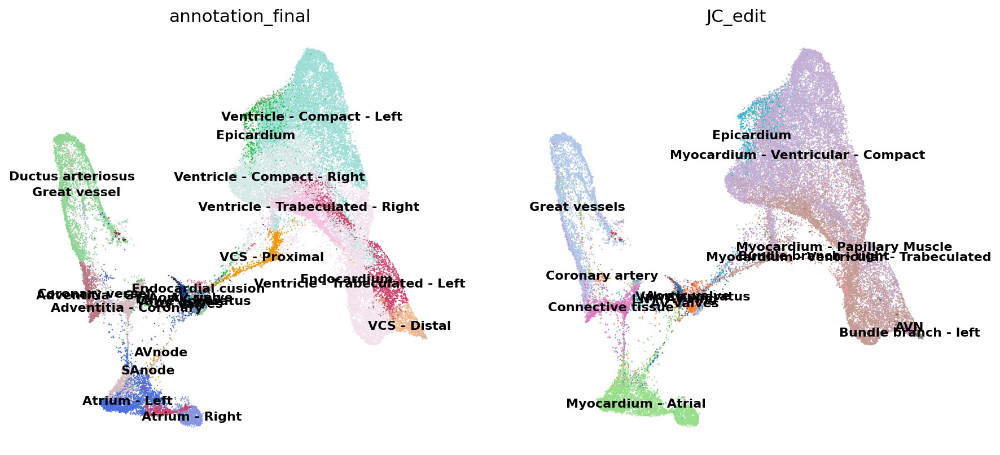

In [95]:
with mpl.rc_context({'axes.facecolor':  'white',
                     'figure.figsize': [6, 6]}):
    sc.pl.umap(adata_vis, color=['annotation_final','JC_edit'], size=5,
               color_map = 'RdPu', ncols = 3, wspace=0.1,
               legend_fontsize=10, frameon=False, legend_loc='on data')

# Save

In [96]:
annot_df.to_csv('/nfs/team205/heart/anndata_objects/Foetal/visium_foetal_healthy-all_spot-annotation.csv')
adata_vis.write('/nfs/team205/heart/anndata_objects/Foetal/visium_foetal_healthy-all_raw.h5ad')

In [ ]:
# rclone to gdrive
rclone copy /nfs/team205/heart/anndata_objects/Foetal/visium_foetal_healthy-all_raw.h5ad \
gdrive:JamesC_Kazumasa/Foetal_Heart/SanjayShinha/toSinhalab/anndata/Visium/